# Generative Adversarial Networks

In this homework you will experiment with the [Deep Convolutional Generative Adversarial Network (DCGAN)](https://arxiv.org/pdf/1511.06434.pdf) for representation learning and image generation.

In [0]:
import numpy as np
import matplotlib as mpl
mpl.rc('image', cmap='gray')
from matplotlib import pyplot as plt

## Data loading and pre-processing

Here we download and unpack the Frey dataset.  The dataset consists of grayscale images, 28 pixels high and 20 pixels wide.

In [2]:
from tensorflow.keras.utils import get_file
from scipy.io import loadmat

path = get_file('frey_rawface.mat','https://cs.nyu.edu/~roweis/data/frey_rawface.mat')
data = np.transpose(loadmat(path)['ff'])
images = np.reshape(data,(-1,28,20))
np.random.seed(1234)
np.random.shuffle(images)
x_train = (images.astype('float32')/255.)*2-1
x_train = np.expand_dims(x_train,axis=-1)

1105920/1100584 [==============================] - 0s 0us/step


(1965, 28, 20)


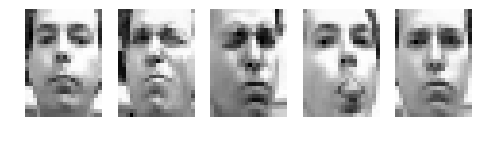

In [3]:
print(images.shape)
for i in range(5):
  plt.subplot(1,5,i+1)
  plt.imshow(images[i])
  plt.axis('off')
plt.show()

## Model implementation and training

I have given the implementation of the DCGAN here.  It is a bit tricky to set up with Keras.

In [13]:
from tensorflow.keras.layers import Input, Flatten, Dense, Conv2D, Conv2DTranspose, Reshape, Lambda, LeakyReLU, BatchNormalization, Activation
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import SGD, Adam
from tensorflow.keras.losses import mse
import tensorflow.keras.backend as K

from tqdm.autonotebook import trange

def get_generator():
  """ Builds the generator network that converts noise into images. """
  
   # Input is a 100-dimensional latent vector
  inputs = Input((100,))
  
  # Fully-connected layer to transform noise into a tensor
#   x = Dense(1024, activation='relu')(inputs)
#   x = Dense(1024, activation='relu')(x)
  
  x = Dense(7*5*64,activation='relu')(inputs) 

  x = Reshape((7,5,64))(x)
  
  # Transposed convolutions to upsample tensor
  x = Conv2DTranspose(32,4,strides=2,activation=None,padding='same')(x)
  x = LeakyReLU(alpha=0.1)(x)

  outputs = Conv2DTranspose(1,4,strides=2,activation='tanh',padding='same')(x)
  
  return Model(inputs=inputs,outputs=outputs)
   
def get_discriminator():
  """ Builds the discriminator network which tries to discriminate real images from fakes. """
  # Input is a 64x64 image
  inputs = Input((28,20,1))
  
  # Strided convolutions to downsample
  x = Conv2D(32,4,strides=2,activation=None,padding='same')(inputs)  
  x = LeakyReLU(alpha=0.1)(x)
  x = Conv2D(64,4,strides=2,activation=None,padding='same')(x)
  x = LeakyReLU(alpha=0.1)(x)

  # Final output with sigmoid activation for binary classification
  x = Flatten()(x)
  outputs = Dense(1,activation='sigmoid')(x)
  
  return Model(inputs=inputs,outputs=outputs)

def setup_gan_training(generator,discriminator):
  g_opt = Adam(lr=0.0002,beta_1=0.5,beta_2=0.999,epsilon=1e-3)
  d_opt = Adam(lr=0.0002,beta_1=0.5,beta_2=0.999,epsilon=1e-3)
#   d_opt = SGD(lr=0.0002, decay=1e-6, momentum=0.9, nesterov=True)

  generator.compile(loss='binary_crossentropy',optimizer=g_opt)
  discriminator.compile(loss='binary_crossentropy',optimizer=d_opt)

  discriminator.trainable = False
  inputs = Input((100,))
  x = generator(inputs)
  outputs = discriminator(x)
  
  d_on_g = Model(inputs=inputs,outputs=outputs)
  d_on_g.compile(loss='binary_crossentropy',optimizer=g_opt)
  
  return d_on_g

def sample_from_generator(generator):
  noise_input = np.random.normal(size=(32,100))
  x_fake = np.squeeze(generator.predict(noise_input))
  n = 0
  for i in range(4):
    for j in range(8):
      plt.subplot(4,8,n+1)
      plt.imshow(x_fake[n])
      plt.axis('off')
      n = n+1
  plt.show()

def train_gan(generator, discriminator, d_on_g,
              x, num_epochs=100, batch_size=64):
  num_batches = len(x) // batch_size
    
  gen_loss_history = []
  discrim_loss_history = []
    
  for i in range(num_epochs):
    inds = np.arange(len(x))
    np.random.shuffle(inds)
        
    for j in trange(num_batches):
      noise_input = np.random.normal(size=(batch_size, 100))
            
      x_real = x[inds[(j*batch_size):((j+1)*batch_size)]]
      y_real = [1]*batch_size

      x_fake = generator.predict(noise_input, batch_size=batch_size)
      y_fake = [0]*batch_size

      discriminator.trainable = True
      for k in range(2):
        real_loss = discriminator.train_on_batch(x_real, y_real)
        fake_loss = discriminator.train_on_batch(x_fake, y_fake)
        discrim_loss = 0.5*(real_loss + fake_loss)
      
      # Train the generator once for every five times the descriminator is trained
      x_generator = np.random.normal(size=(batch_size, 100))
      y_generator = [1]*batch_size
      discriminator.trainable = False
      gen_loss = d_on_g.train_on_batch(x_generator, y_generator)
      gen_loss_history.append(gen_loss)
      
      discrim_loss_history.append(discrim_loss)
      
      
    print('epoch %d: discriminator loss: %.2f\tgenerator loss: %.2f'%(i+1,discrim_loss,gen_loss))
    sample_from_generator(generator)
    
  return gen_loss_history, discrim_loss_history

generator = get_generator()
discriminator = get_discriminator()
d_on_g = setup_gan_training(generator,discriminator)

print(generator.summary())
print(discriminator.summary())


_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_10 (InputLayer)        (None, 100)               0         
_________________________________________________________________
dense_6 (Dense)              (None, 2240)              226240    
_________________________________________________________________
reshape_3 (Reshape)          (None, 7, 5, 64)          0         
_________________________________________________________________
conv2d_transpose_6 (Conv2DTr (None, 14, 10, 32)        32800     
_________________________________________________________________
leaky_re_lu_9 (LeakyReLU)    (None, 14, 10, 32)        0         
_________________________________________________________________
conv2d_transpose_7 (Conv2DTr (None, 28, 20, 1)         513       
Total params: 259,553
Trainable params: 259,553
Non-trainable params: 0
_________________________________________________________________
None


epoch 1: discriminator loss: 0.37	generator loss: 0.72


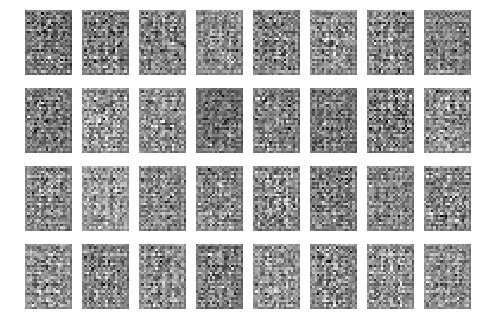


epoch 2: discriminator loss: 0.19	generator loss: 1.70


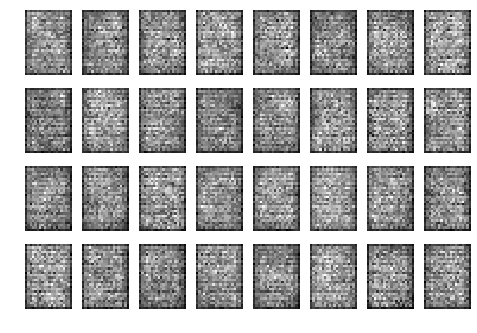


epoch 3: discriminator loss: 0.04	generator loss: 2.89


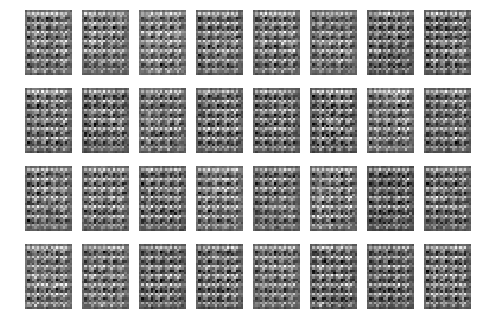


epoch 4: discriminator loss: 0.02	generator loss: 3.43


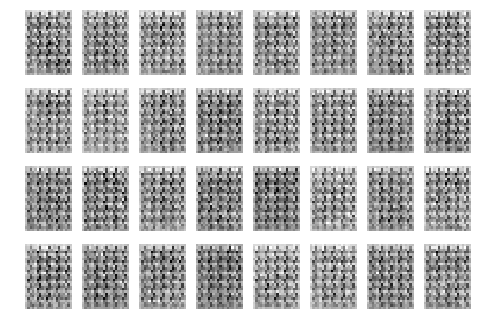


epoch 5: discriminator loss: 0.01	generator loss: 3.78


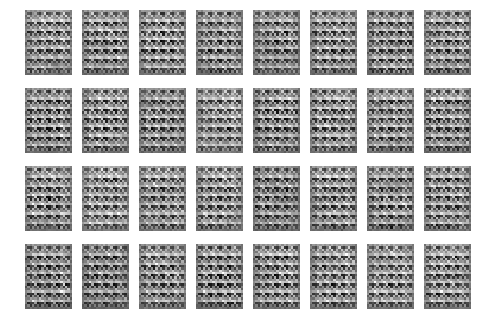


epoch 6: discriminator loss: 0.06	generator loss: 3.42


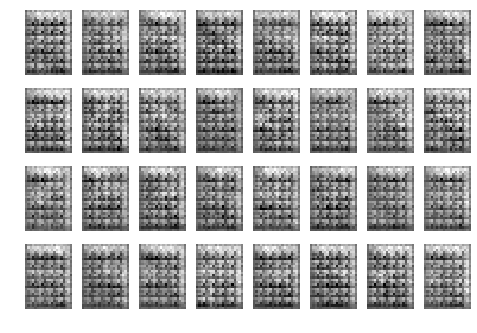


epoch 7: discriminator loss: 0.22	generator loss: 2.58


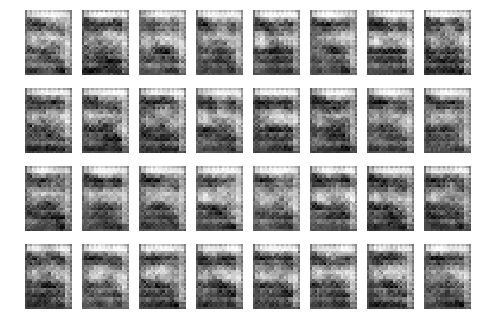


epoch 8: discriminator loss: 0.24	generator loss: 2.40


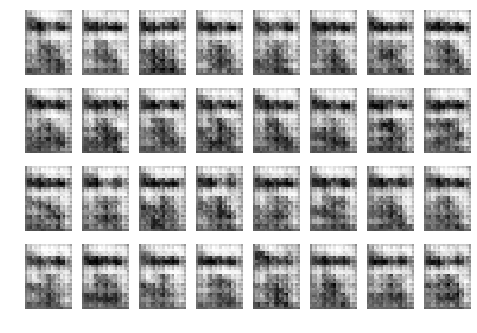


epoch 9: discriminator loss: 0.27	generator loss: 2.84


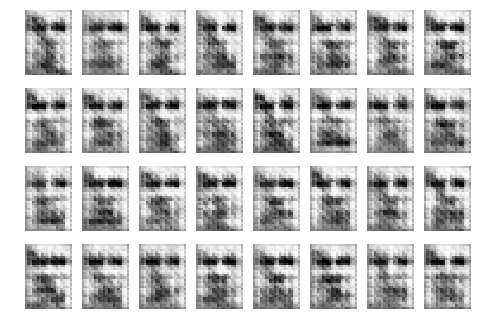


epoch 10: discriminator loss: 0.23	generator loss: 2.55


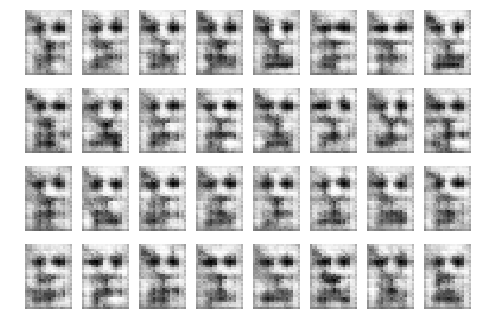


epoch 11: discriminator loss: 0.25	generator loss: 2.05


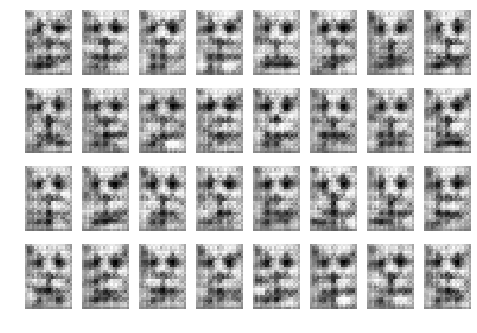


epoch 12: discriminator loss: 0.26	generator loss: 2.15


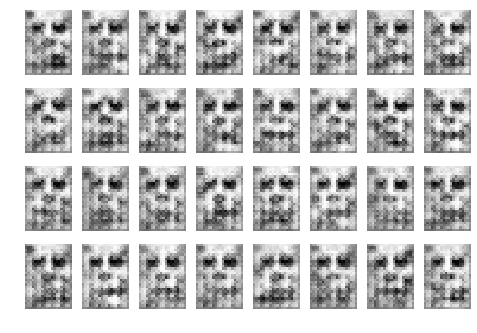


epoch 13: discriminator loss: 0.43	generator loss: 1.79


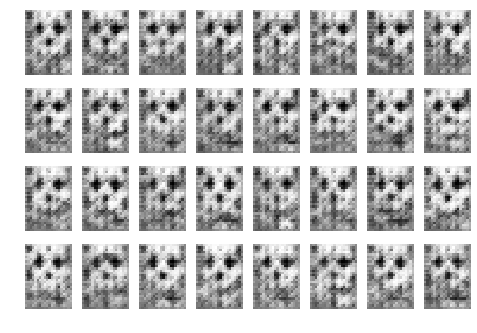


epoch 14: discriminator loss: 0.18	generator loss: 2.15


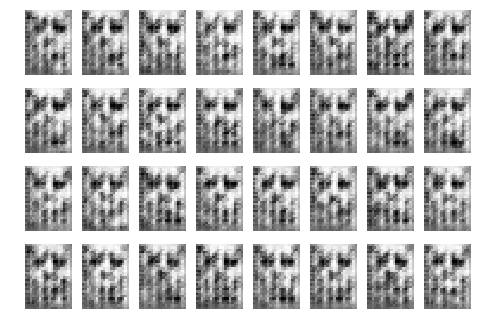


epoch 15: discriminator loss: 0.40	generator loss: 1.82


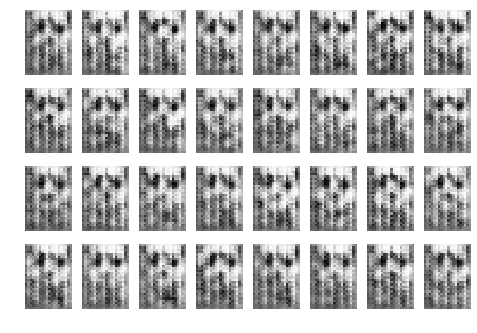


epoch 16: discriminator loss: 0.26	generator loss: 1.99


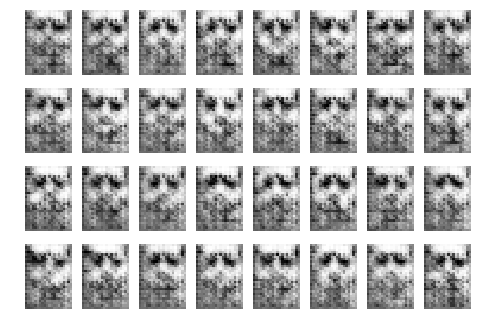


epoch 17: discriminator loss: 0.20	generator loss: 2.28


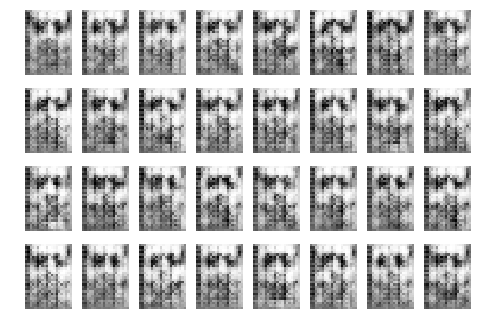


epoch 18: discriminator loss: 0.35	generator loss: 1.89


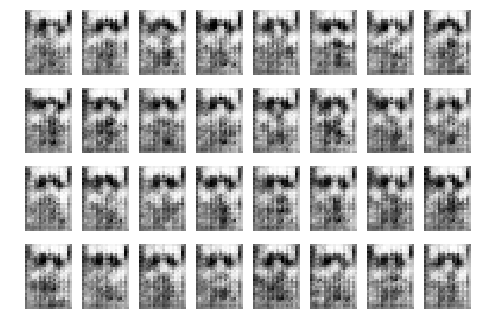


epoch 19: discriminator loss: 0.40	generator loss: 1.76


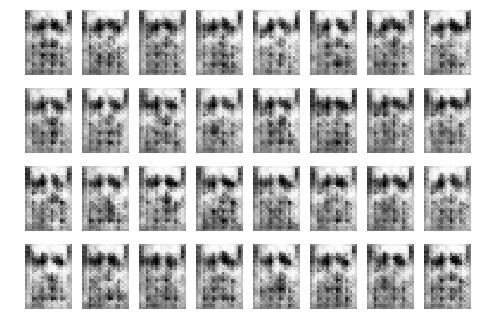


epoch 20: discriminator loss: 0.33	generator loss: 1.62


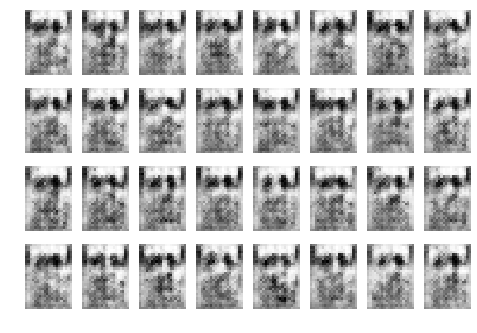


epoch 21: discriminator loss: 0.38	generator loss: 1.74


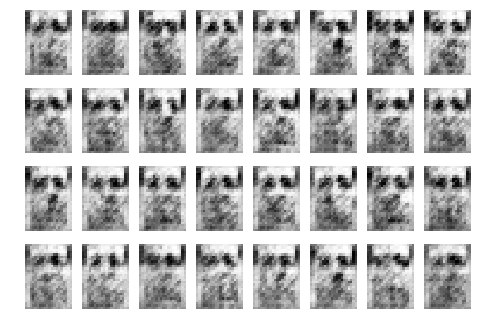


epoch 22: discriminator loss: 0.37	generator loss: 1.69


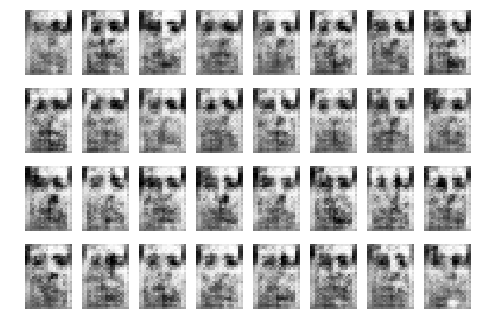


epoch 23: discriminator loss: 0.52	generator loss: 1.45


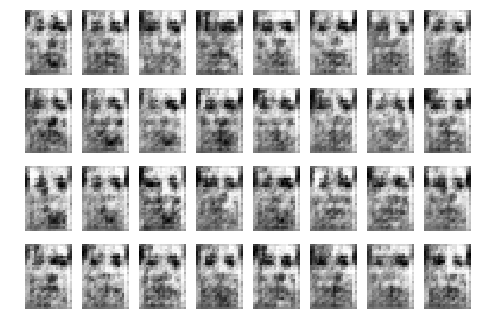


epoch 24: discriminator loss: 0.50	generator loss: 1.32


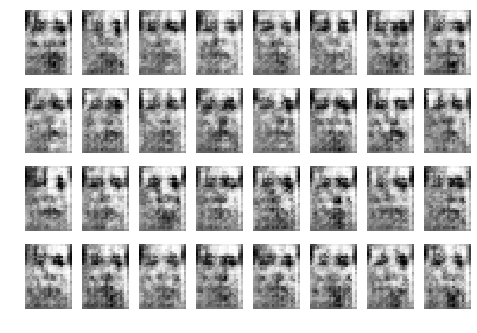


epoch 25: discriminator loss: 0.55	generator loss: 1.30


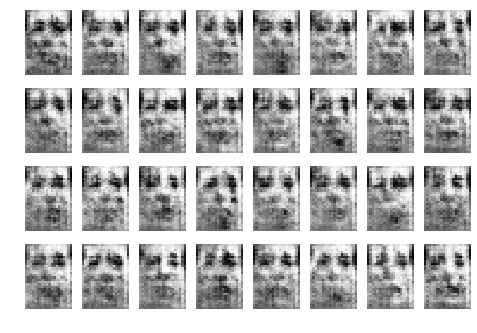


epoch 26: discriminator loss: 0.51	generator loss: 1.27


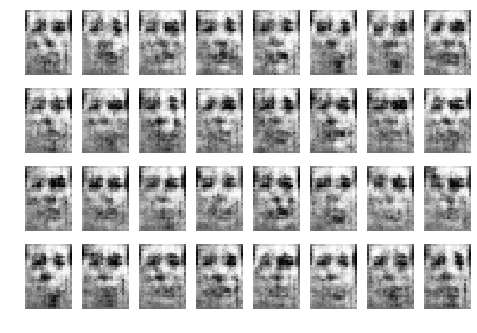


epoch 27: discriminator loss: 0.46	generator loss: 1.27


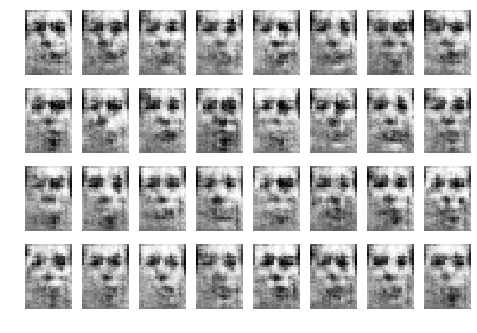


epoch 28: discriminator loss: 0.58	generator loss: 1.26


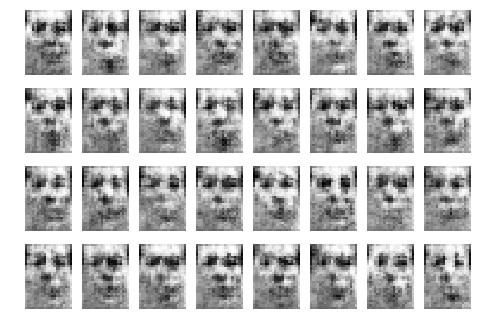


epoch 29: discriminator loss: 0.50	generator loss: 1.10


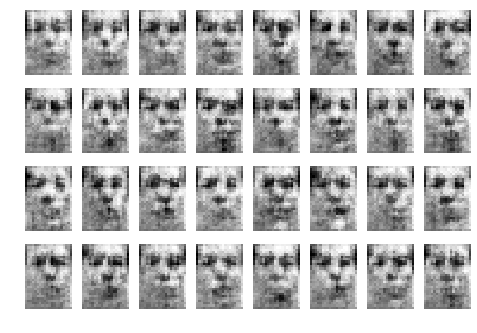


epoch 30: discriminator loss: 0.58	generator loss: 1.05


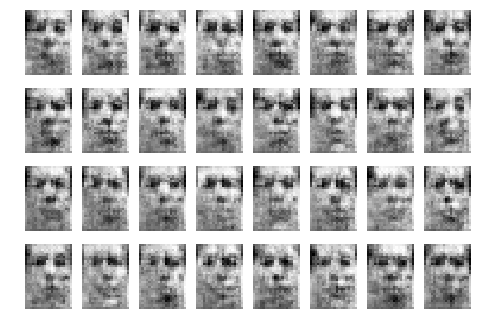


epoch 31: discriminator loss: 0.58	generator loss: 0.95


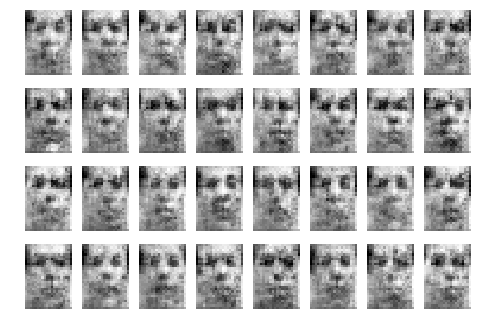


epoch 32: discriminator loss: 0.53	generator loss: 0.93


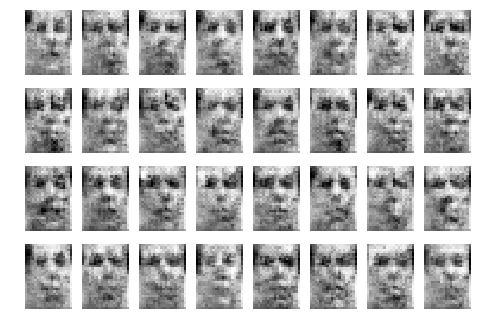


epoch 33: discriminator loss: 0.51	generator loss: 0.97


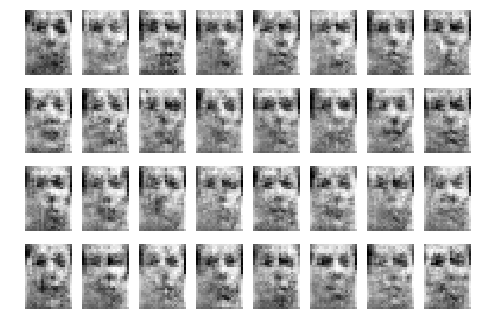


epoch 34: discriminator loss: 0.48	generator loss: 1.01


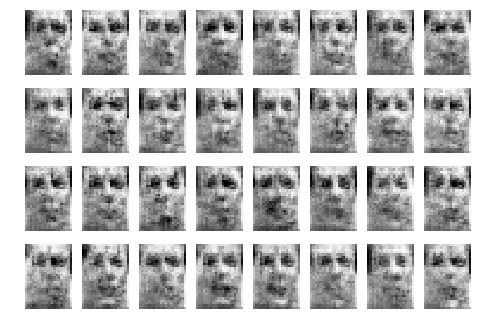


epoch 35: discriminator loss: 0.44	generator loss: 1.09


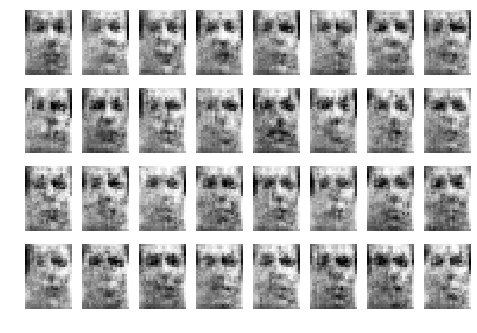


epoch 36: discriminator loss: 0.45	generator loss: 1.10


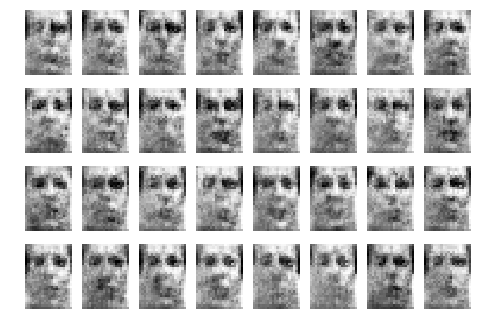


epoch 37: discriminator loss: 0.48	generator loss: 1.04


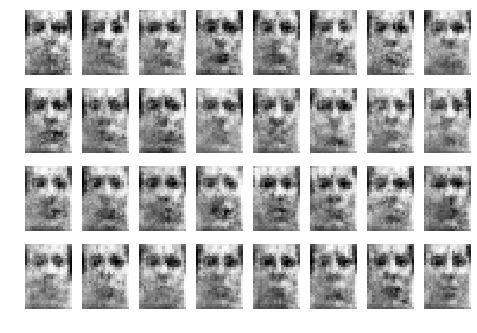


epoch 38: discriminator loss: 0.49	generator loss: 1.01


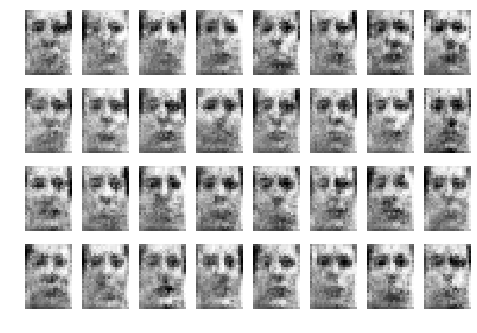


epoch 39: discriminator loss: 0.48	generator loss: 1.13


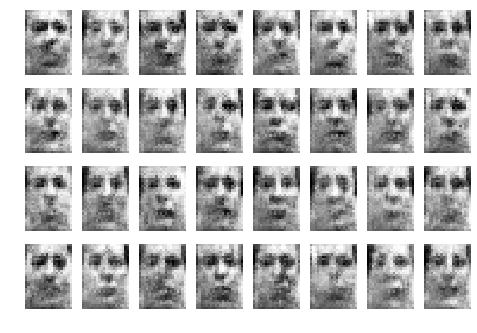


epoch 40: discriminator loss: 0.49	generator loss: 1.19


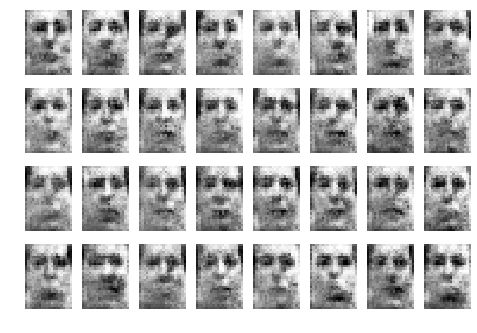


epoch 41: discriminator loss: 0.51	generator loss: 1.10


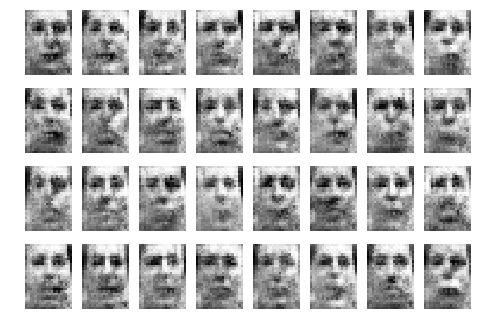


epoch 42: discriminator loss: 0.56	generator loss: 1.05


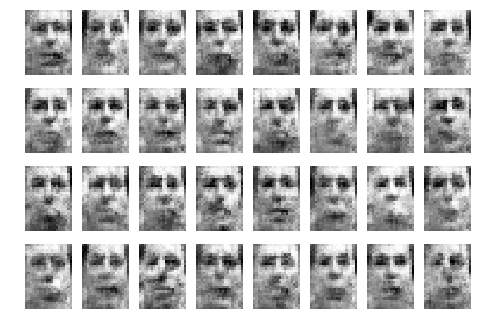


epoch 43: discriminator loss: 0.53	generator loss: 1.06


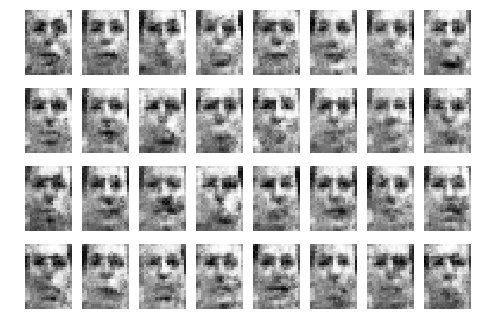


epoch 44: discriminator loss: 0.48	generator loss: 1.08


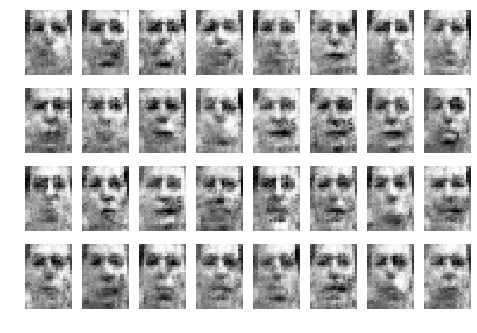


epoch 45: discriminator loss: 0.48	generator loss: 1.16


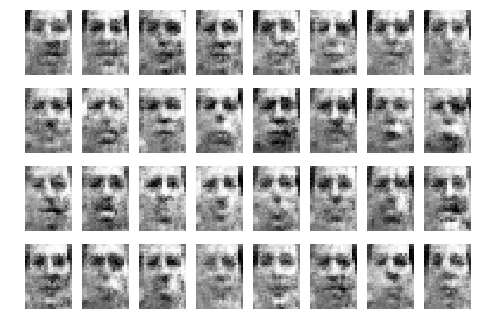


epoch 46: discriminator loss: 0.47	generator loss: 1.15


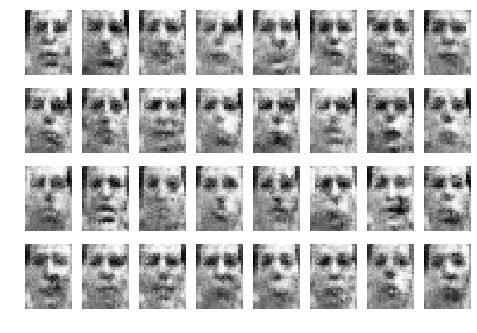


epoch 47: discriminator loss: 0.49	generator loss: 1.12


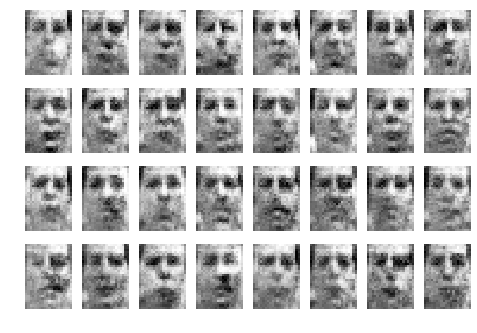


epoch 48: discriminator loss: 0.46	generator loss: 1.17


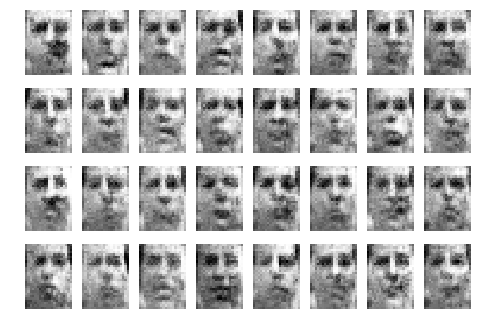


epoch 49: discriminator loss: 0.45	generator loss: 1.21


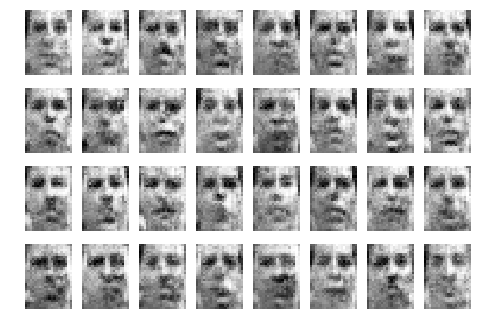


epoch 50: discriminator loss: 0.44	generator loss: 1.12


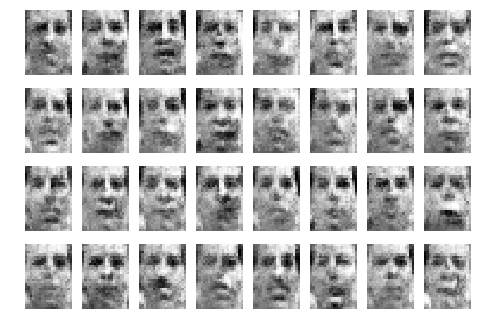


epoch 51: discriminator loss: 0.46	generator loss: 1.09


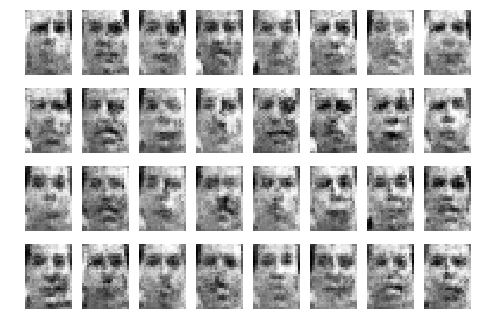


epoch 52: discriminator loss: 0.47	generator loss: 1.16


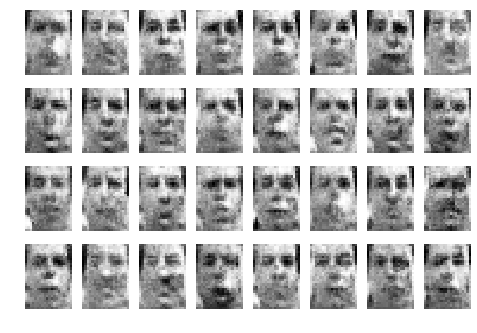


epoch 53: discriminator loss: 0.44	generator loss: 1.14


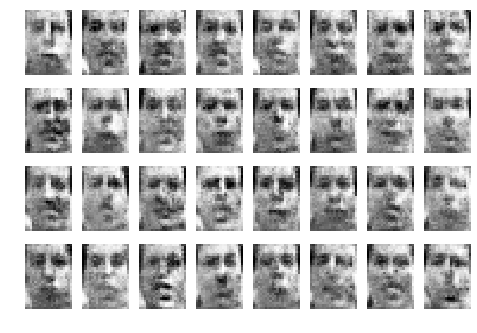


epoch 54: discriminator loss: 0.44	generator loss: 1.22


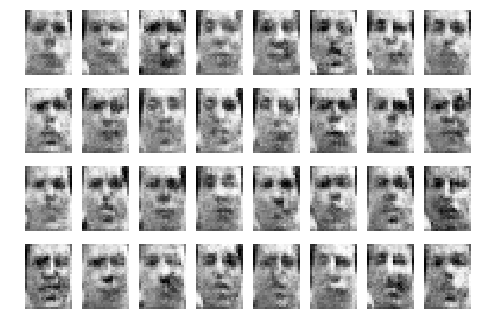


epoch 55: discriminator loss: 0.50	generator loss: 1.11


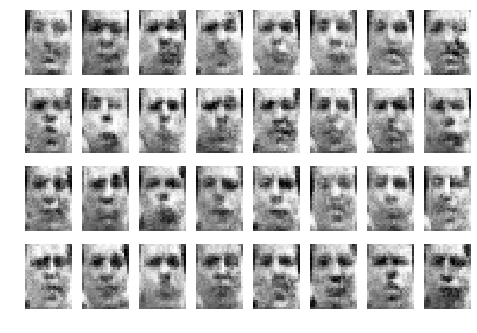


epoch 56: discriminator loss: 0.49	generator loss: 1.10


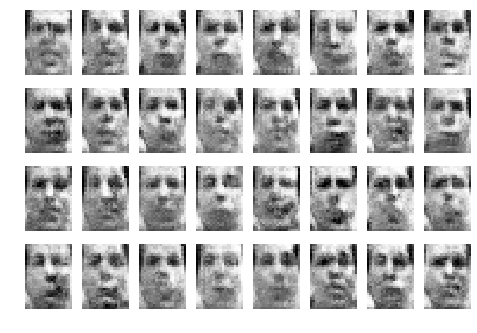


epoch 57: discriminator loss: 0.49	generator loss: 1.07


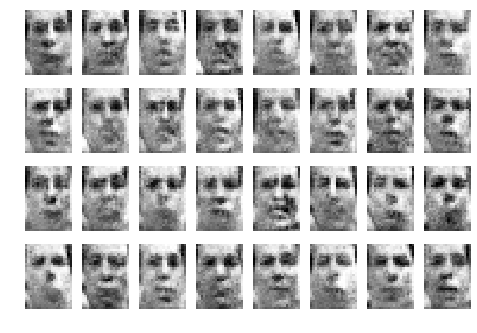


epoch 58: discriminator loss: 0.52	generator loss: 1.08


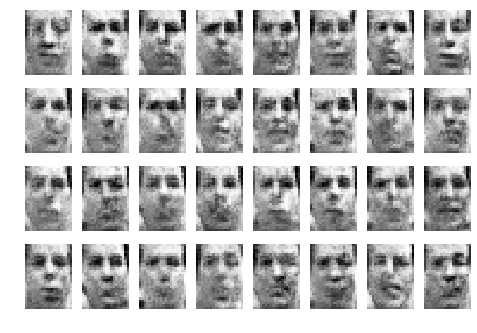


epoch 59: discriminator loss: 0.57	generator loss: 1.09


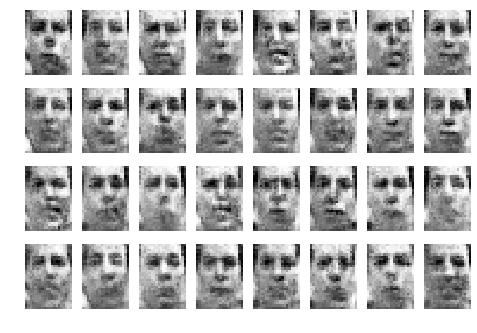


epoch 60: discriminator loss: 0.53	generator loss: 1.12


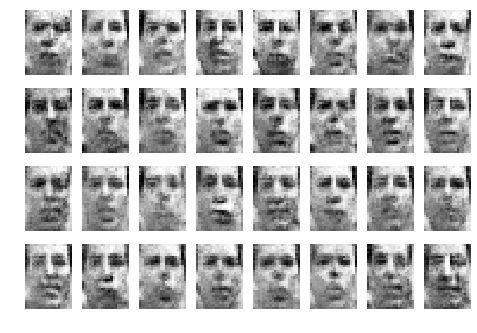


epoch 61: discriminator loss: 0.57	generator loss: 1.11


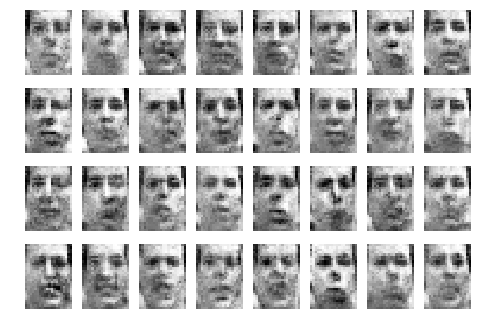


epoch 62: discriminator loss: 0.57	generator loss: 0.93


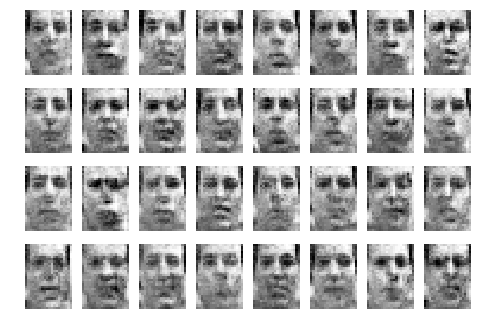


epoch 63: discriminator loss: 0.58	generator loss: 0.99


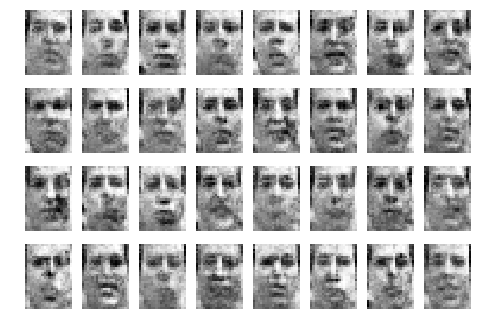


epoch 64: discriminator loss: 0.57	generator loss: 1.08


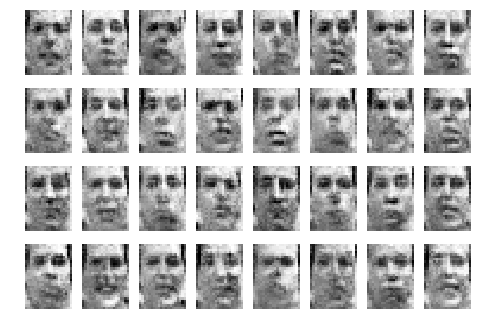


epoch 65: discriminator loss: 0.57	generator loss: 1.03


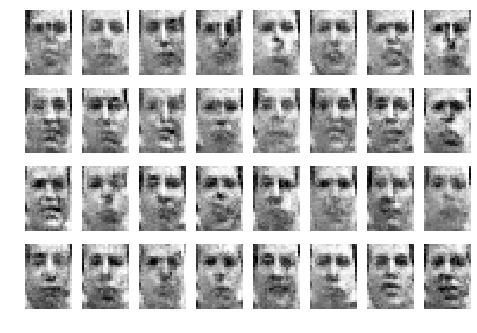


epoch 66: discriminator loss: 0.51	generator loss: 1.07


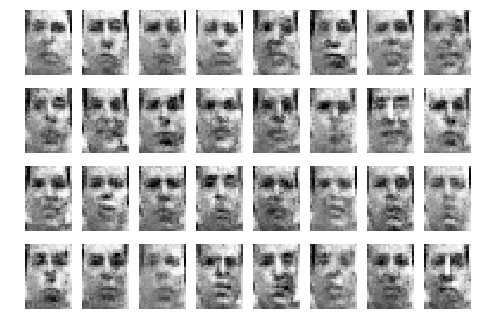


epoch 67: discriminator loss: 0.54	generator loss: 1.06


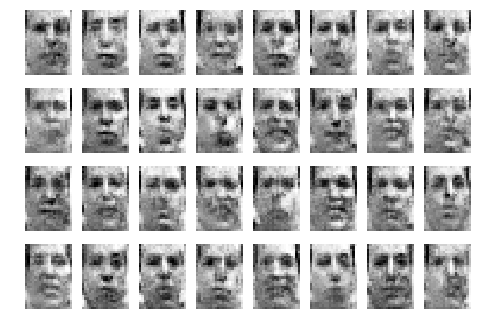


epoch 68: discriminator loss: 0.56	generator loss: 1.06


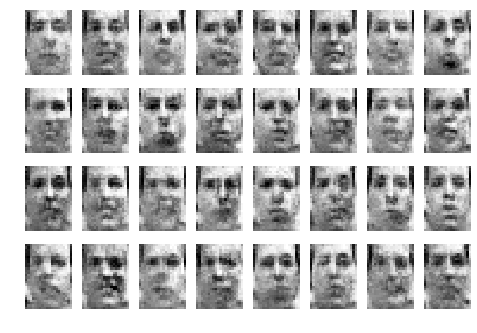


epoch 69: discriminator loss: 0.60	generator loss: 1.03


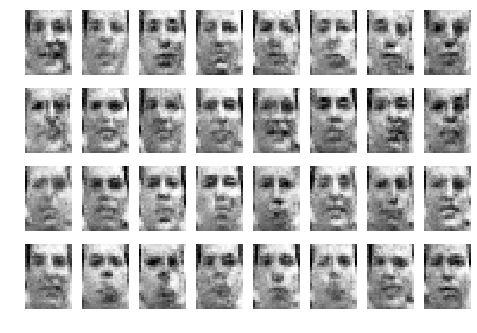


epoch 70: discriminator loss: 0.57	generator loss: 1.02


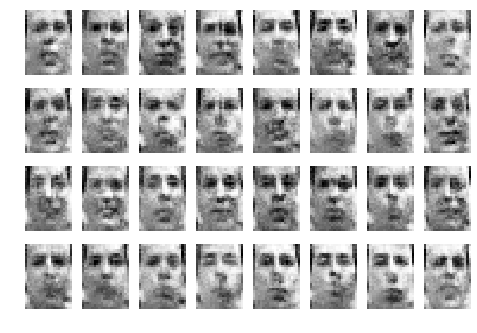


epoch 71: discriminator loss: 0.57	generator loss: 1.04


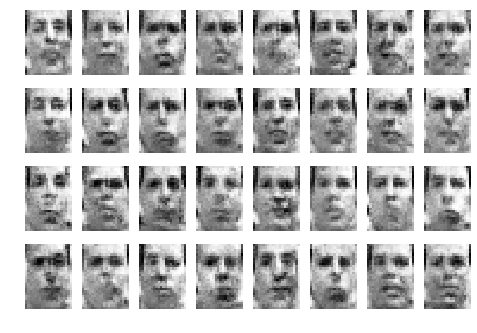


epoch 72: discriminator loss: 0.54	generator loss: 1.03


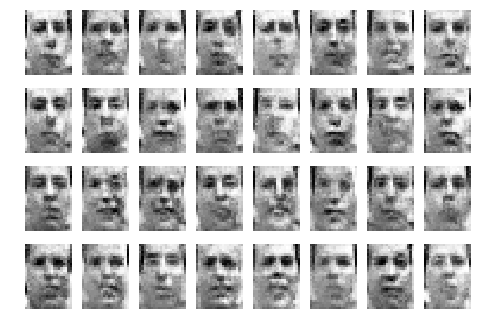


epoch 73: discriminator loss: 0.54	generator loss: 1.04


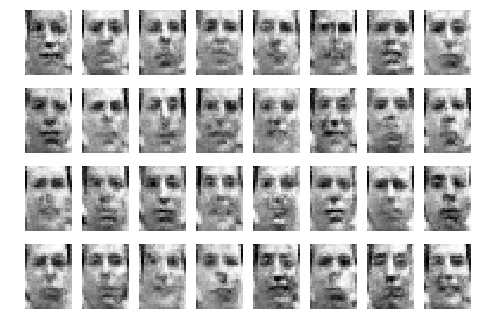


epoch 74: discriminator loss: 0.56	generator loss: 0.97


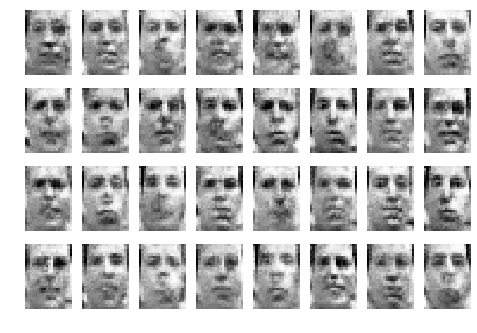


epoch 75: discriminator loss: 0.58	generator loss: 1.01


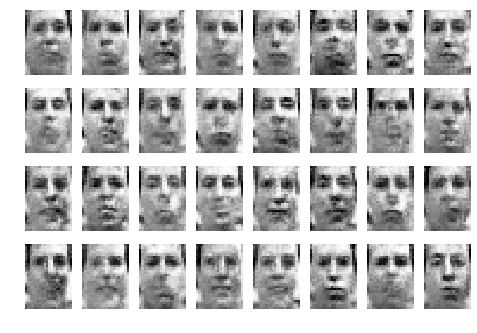


epoch 76: discriminator loss: 0.57	generator loss: 1.04


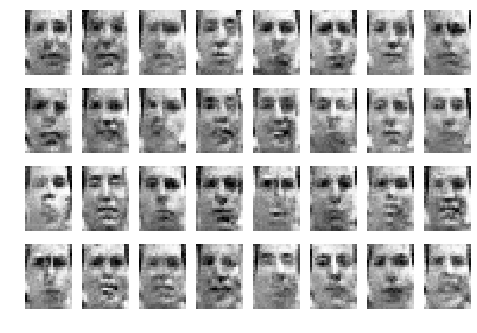


epoch 77: discriminator loss: 0.57	generator loss: 0.96


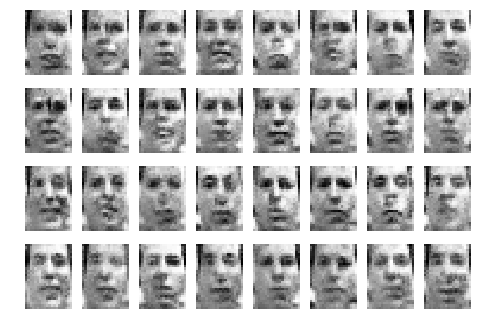


epoch 78: discriminator loss: 0.53	generator loss: 0.97


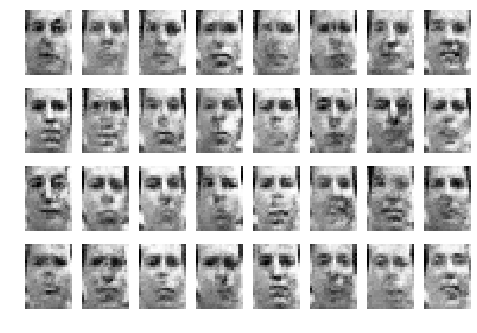


epoch 79: discriminator loss: 0.60	generator loss: 0.96


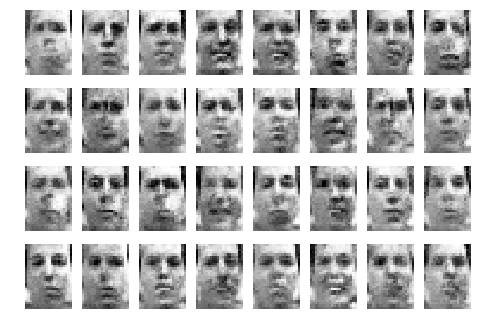


epoch 80: discriminator loss: 0.57	generator loss: 0.94


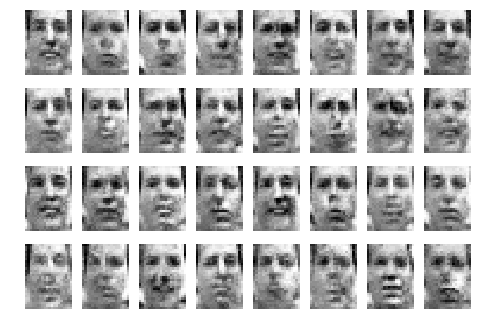


epoch 81: discriminator loss: 0.53	generator loss: 0.98


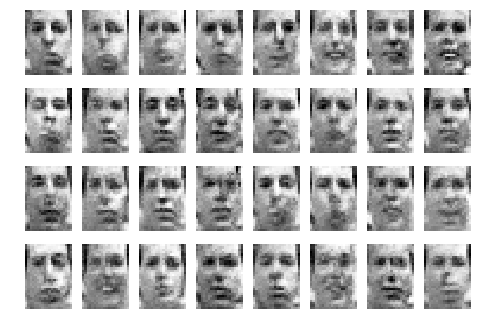


epoch 82: discriminator loss: 0.59	generator loss: 1.02


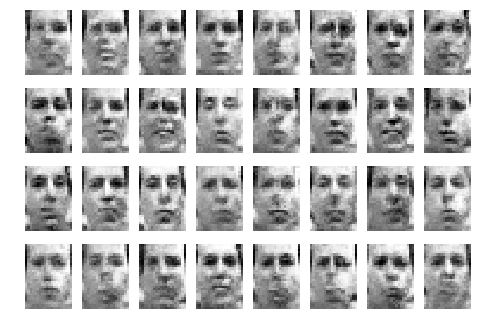


epoch 83: discriminator loss: 0.59	generator loss: 1.00


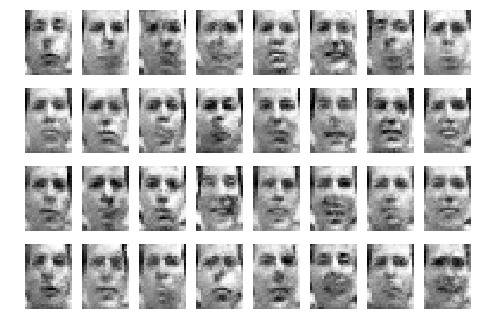


epoch 84: discriminator loss: 0.57	generator loss: 0.96


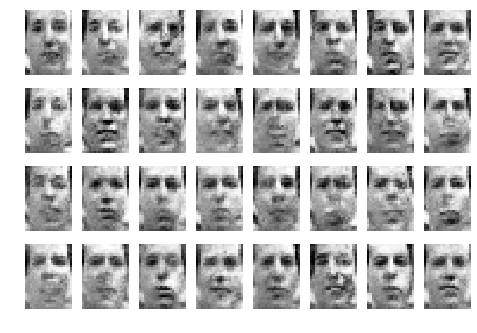


epoch 85: discriminator loss: 0.56	generator loss: 0.99


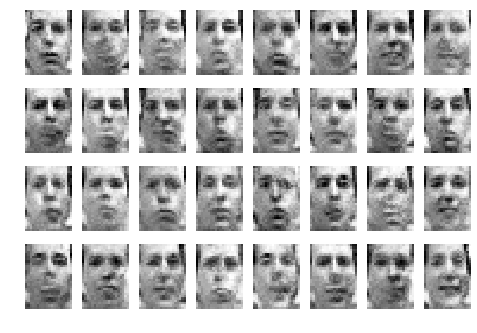


epoch 86: discriminator loss: 0.55	generator loss: 1.00


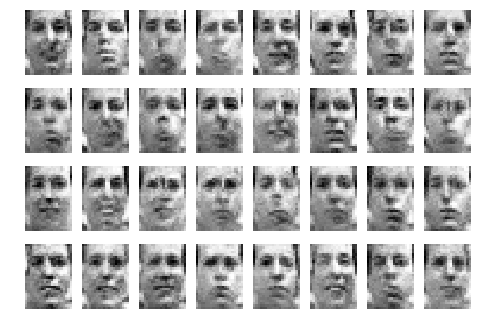


epoch 87: discriminator loss: 0.56	generator loss: 1.02


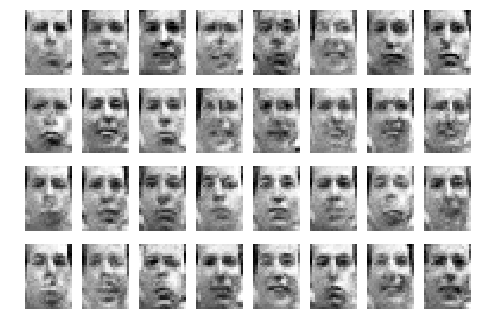


epoch 88: discriminator loss: 0.56	generator loss: 0.93


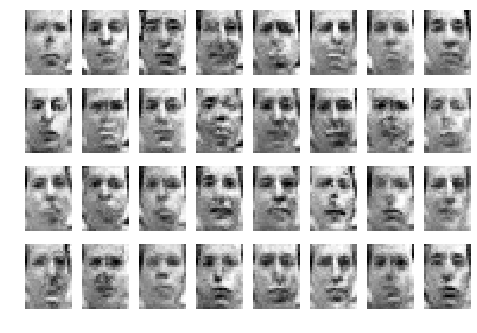


epoch 89: discriminator loss: 0.62	generator loss: 0.99


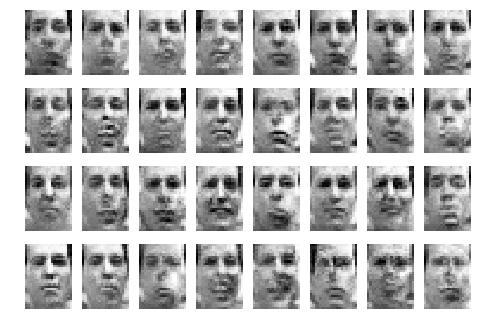


epoch 90: discriminator loss: 0.57	generator loss: 0.94


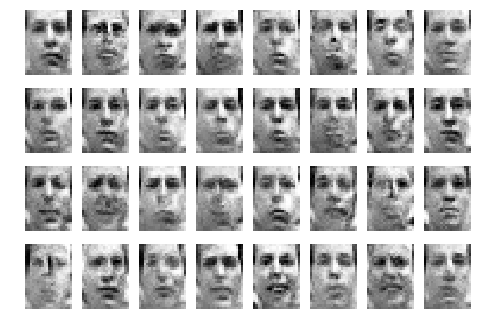


epoch 91: discriminator loss: 0.60	generator loss: 0.98


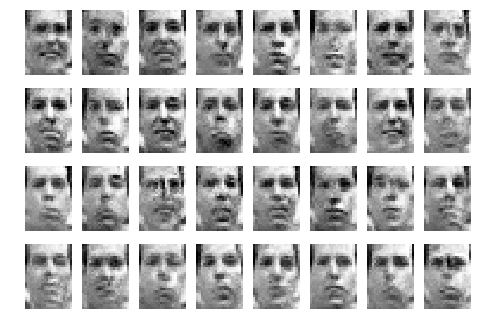


epoch 92: discriminator loss: 0.58	generator loss: 1.01


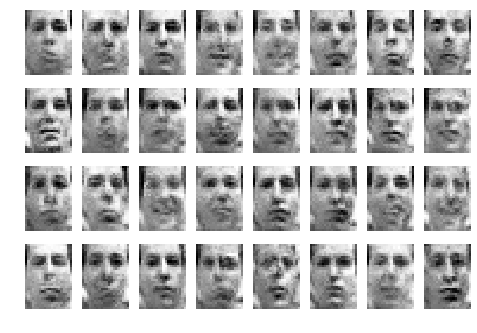


epoch 93: discriminator loss: 0.55	generator loss: 0.95


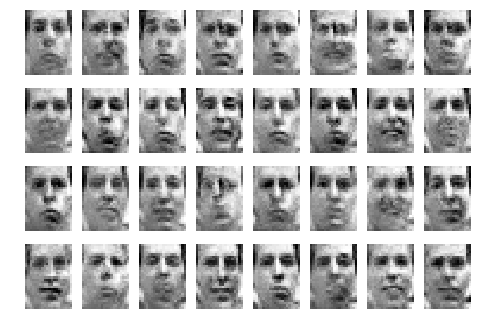


epoch 94: discriminator loss: 0.58	generator loss: 1.02


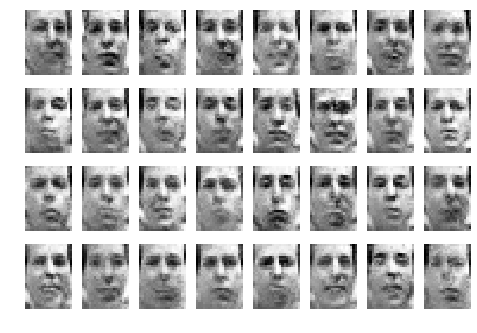


epoch 95: discriminator loss: 0.55	generator loss: 0.96


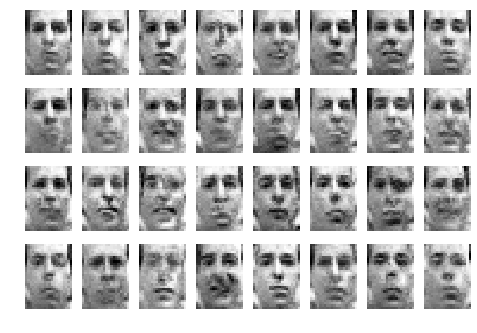


epoch 96: discriminator loss: 0.55	generator loss: 1.01


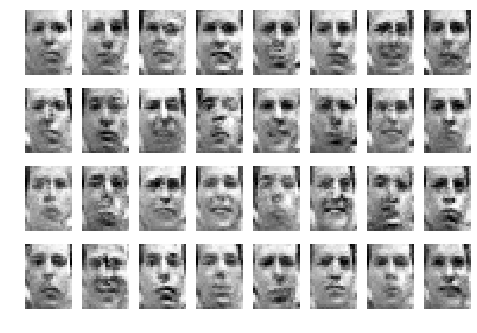


epoch 97: discriminator loss: 0.56	generator loss: 0.95


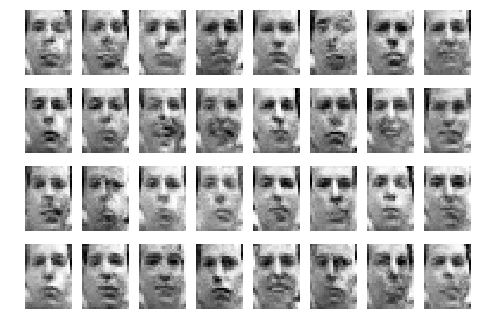


epoch 98: discriminator loss: 0.57	generator loss: 0.91


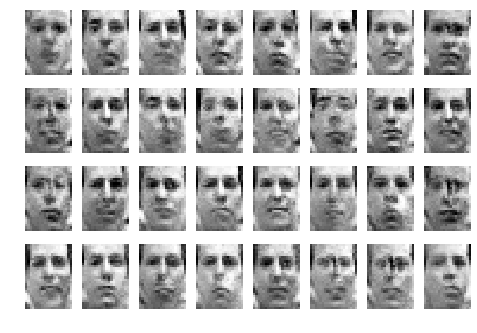


epoch 99: discriminator loss: 0.56	generator loss: 0.96


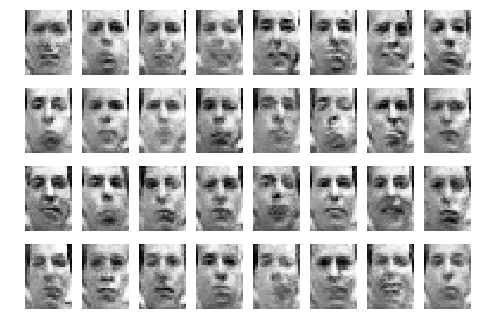


epoch 100: discriminator loss: 0.59	generator loss: 0.86


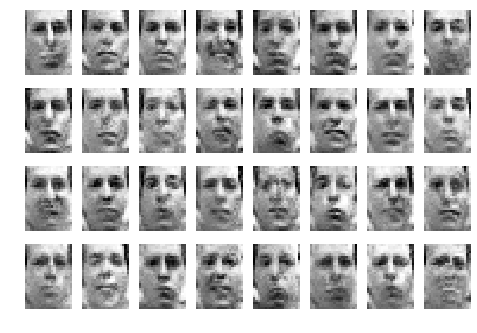

In [14]:
gen_loss_history, discrim_loss_history = train_gan(generator,discriminator,d_on_g,x_train)

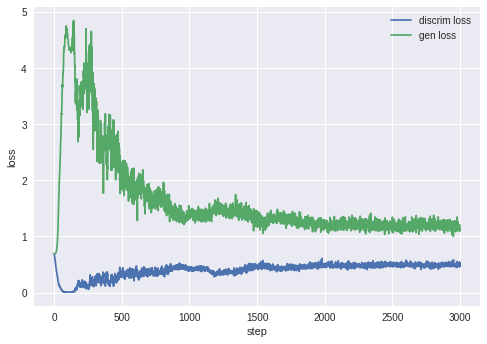

In [12]:
plt.plot(discrim_loss_history)
plt.plot(gen_loss_history)
plt.xlabel('step')
plt.ylabel('loss')
plt.legend(['discrim loss','gen loss'])
plt.show()

## Exercises

* Try to improve the DCGAN -- can you get the reconstructed images to look sharper and less noisy?  Possible things to try: change # of parameters in generator discriminator; change type of optimzer / learning rate; change batch size or other hyperparameters.
* Do you see evidence of mode collapse in the results of GAN training?  Does the generator seem to be able to generate everything that is in the training set?
* Try the Least Squares GAN (LSGAN) -- this simply means changing the loss function to be mean squared error rather than binary crossentropy.  Is there any effect on the GAN training or results?
* Train a DCGAN on the LFW dataset and analyze the results.  I put a loader below which resizes and crops to 28x20.



#### 1. Try to improve the DCGAN -- can you get the reconstructed images to look sharper and less noisy? Possible things to try: change # of parameters in generator discriminator; change type of optimzer / learning rate; change batch size or other hyperparameters.


The changes to the DCGAN as inspired by this repo: https://github.com/soumith/ganhacks as well as in class discussions.

I first tried adding 2 dense layers in the generator. The first layer had 1024 units and the second layer also had 1024 units. This resulted in mode collapse where the generator would only produce images of the man starting directly into the camera and half opening his mouth.

Additionally, I also tried to change the loss function from Adam to SGD in the discriminator. However the output images did not look realistic because the images were always blury. Changing the discriminator to SGD also resulted in mode collapse because each of the blury images looked identical.

Lastly, I tried training the discriminator more than the generator. After a few iterations, I settled on training the discriminator 2 times for every time the generator was training. Although the images don't appear as sharp as I would like, I don't see evidence of mode collapse when using this approach when compared to that of the previous two approaches. 

#### 2. Do you see evidence of mode collapse in the results of GAN training? Does the generator seem to be able to generate everything that is in the training set?

Yes. Mode collapse was a problem when I added dense layers to the generator and when I switched the discriminator's loss function from Adam to SGD. 

However, the GAN where I trained the discriminator 2 times for every time I trained the generator does not have as much evidence for mode collapse. For this model, there appears to be some consistent blurring occuring in the lower right hand corner of the image and there isn't much variation in the man's mouth. However, the GAN is sort of able to generate images of the man's face looking in different directions. Overall, the generator does not perform super well because it cannot generate everything in the training set.

#### 3. Try the Least Squares GAN (LSGAN) -- this simply means changing the loss function to be mean squared error rather than binary crossentropy. Is there any effect on the GAN training or results?

It appears that the discriminator loss and generator loss values are slightly lower than the previous implementation, at 0.21 and 0.33 repectively. However, I don't see much of a difference in the output... One of the largest differences I see is that the sampled images have more definition around the man's mouth. For example, a few of the images generated are of the man smiling whereas in the original DCGAN the generated images are of the man frowning. Another interesting observation about the training is that the generator's loss was at its lowest right after 1000 steps and then began to increase (see graph). These results contrast the DCGAN's loss in the previous problem because the generator's loss steadily decreased until it hit a plateau of around 1.

Instructions for updating:
Use tf.cast instead.



epoch 1: discriminator loss: 0.14	generator loss: 0.26


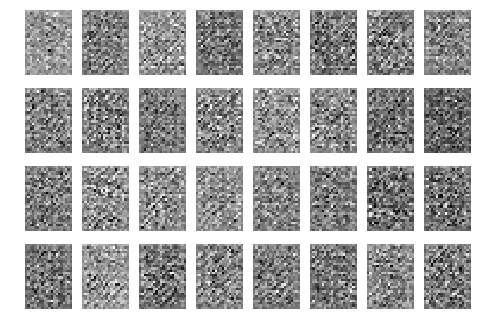


epoch 2: discriminator loss: 0.06	generator loss: 0.48


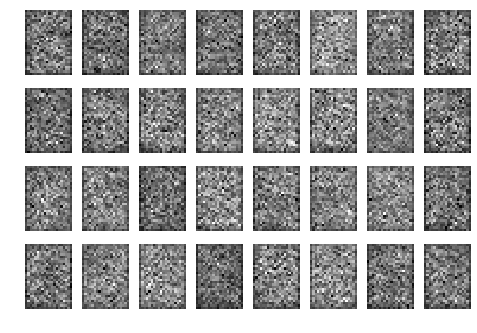


epoch 3: discriminator loss: 0.02	generator loss: 0.76


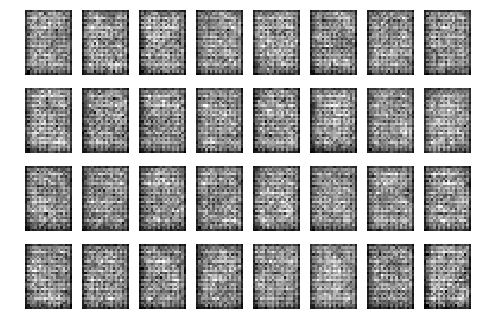


epoch 4: discriminator loss: 0.00	generator loss: 0.88


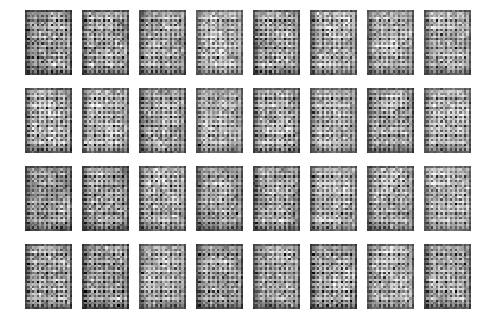


epoch 5: discriminator loss: 0.00	generator loss: 0.91


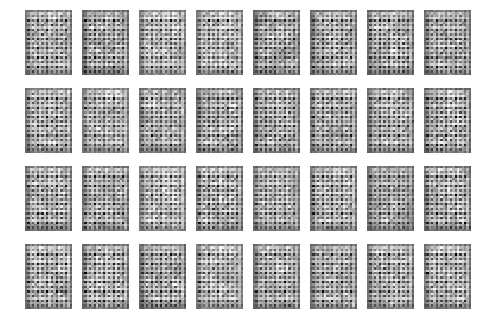


epoch 6: discriminator loss: 0.00	generator loss: 0.90


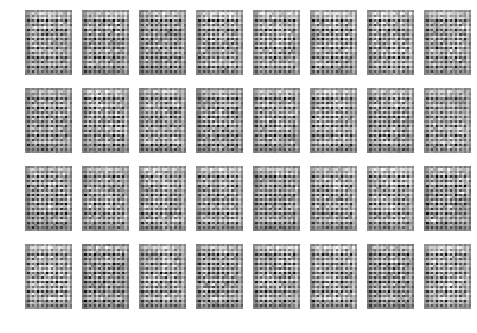


epoch 7: discriminator loss: 0.00	generator loss: 0.88


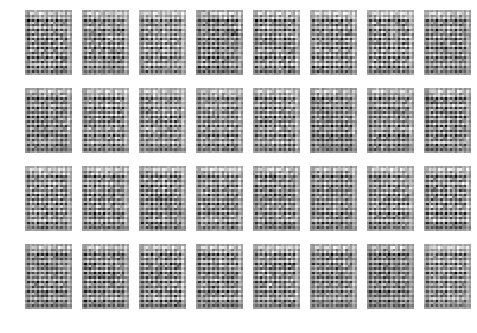


epoch 8: discriminator loss: 0.00	generator loss: 0.92


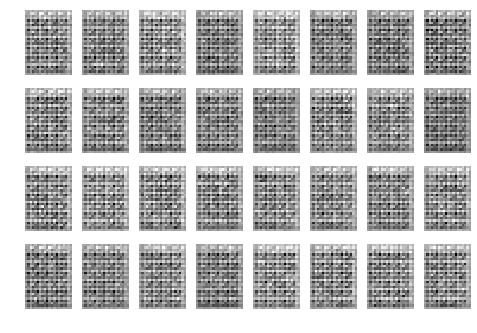


epoch 9: discriminator loss: 0.00	generator loss: 0.92


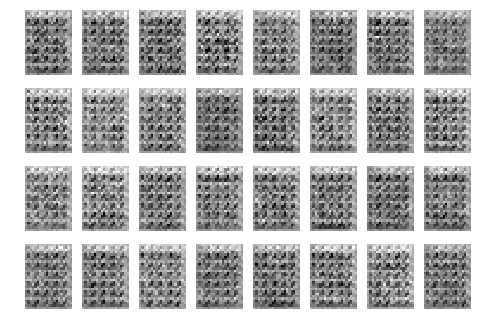


epoch 10: discriminator loss: 0.00	generator loss: 0.87


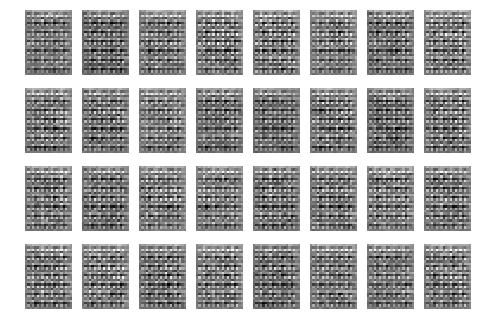


epoch 11: discriminator loss: 0.00	generator loss: 0.94


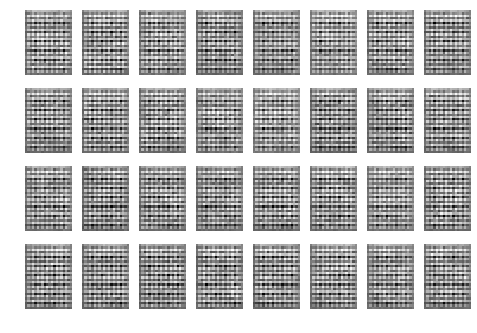


epoch 12: discriminator loss: 0.00	generator loss: 0.96


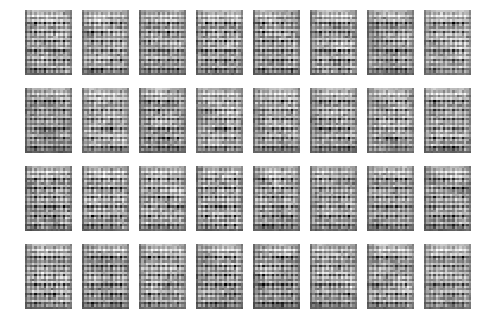


epoch 13: discriminator loss: 0.00	generator loss: 0.96


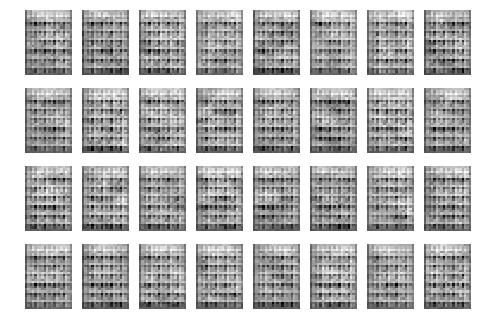


epoch 14: discriminator loss: 0.01	generator loss: 0.87


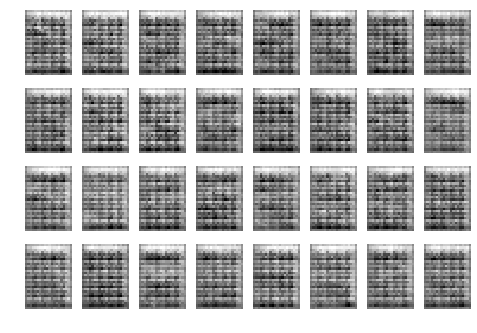


epoch 15: discriminator loss: 0.02	generator loss: 0.90


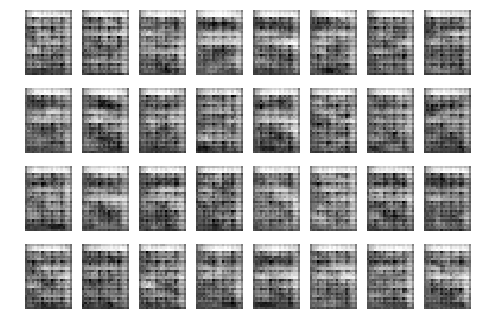


epoch 16: discriminator loss: 0.04	generator loss: 0.86


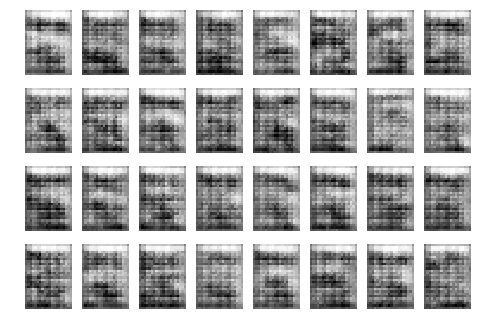


epoch 17: discriminator loss: 0.03	generator loss: 0.89


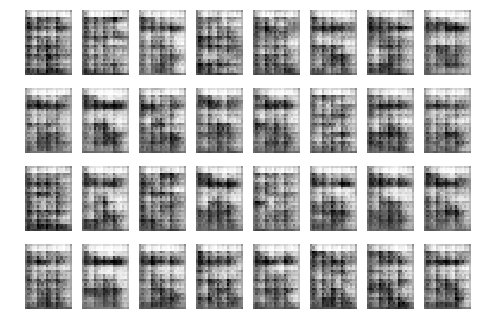


epoch 18: discriminator loss: 0.05	generator loss: 0.94


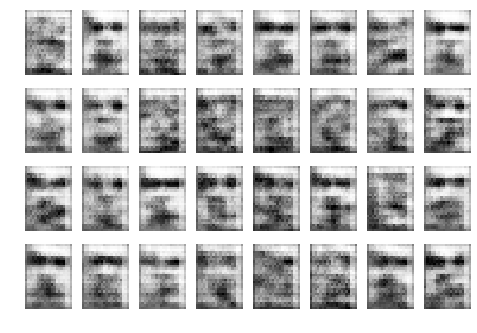


epoch 19: discriminator loss: 0.05	generator loss: 0.89


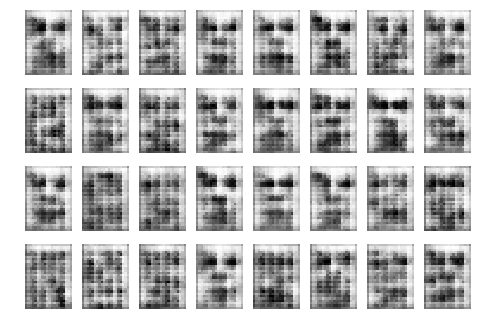


epoch 20: discriminator loss: 0.07	generator loss: 0.88


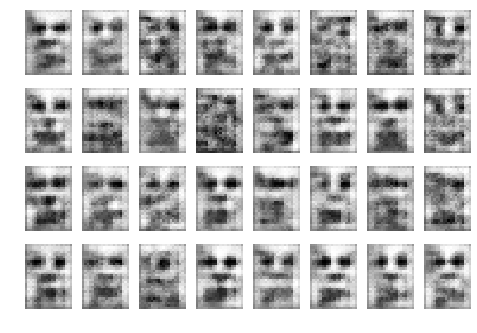


epoch 21: discriminator loss: 0.07	generator loss: 0.84


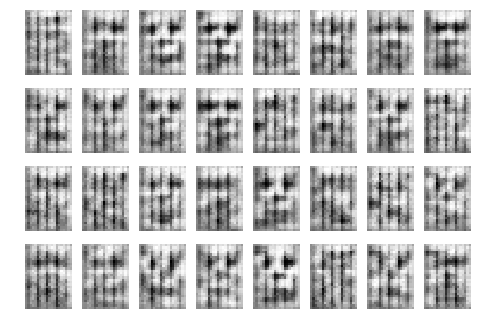


epoch 22: discriminator loss: 0.16	generator loss: 0.69


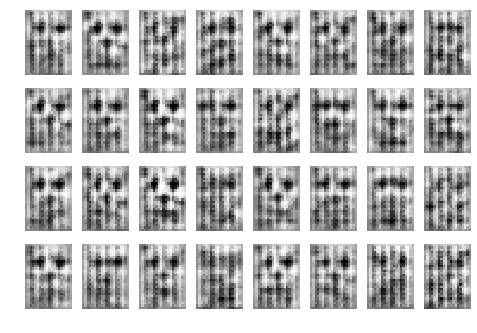


epoch 23: discriminator loss: 0.06	generator loss: 0.83


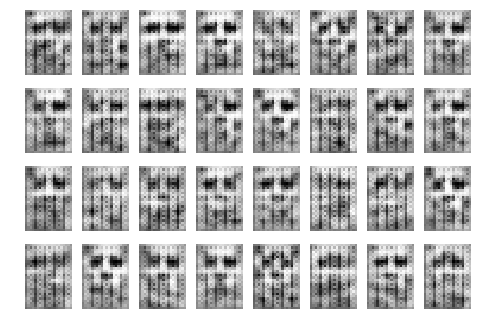


epoch 24: discriminator loss: 0.06	generator loss: 0.78


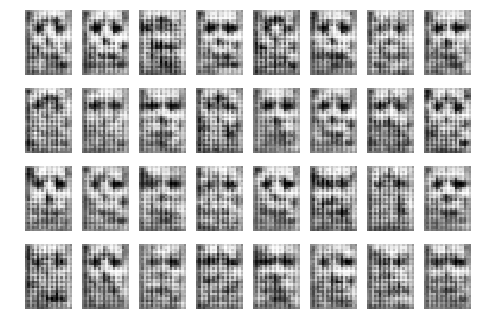


epoch 25: discriminator loss: 0.10	generator loss: 0.65


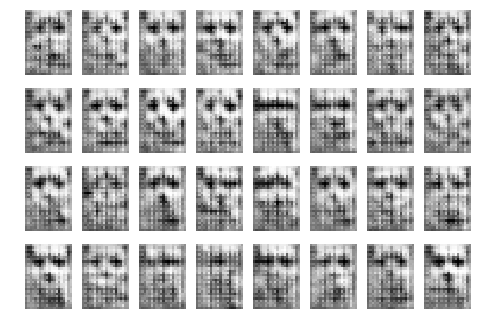


epoch 26: discriminator loss: 0.10	generator loss: 0.72


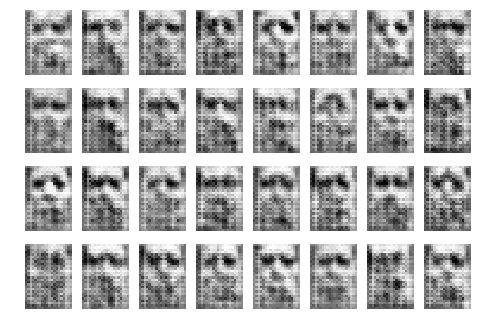


epoch 27: discriminator loss: 0.10	generator loss: 0.68


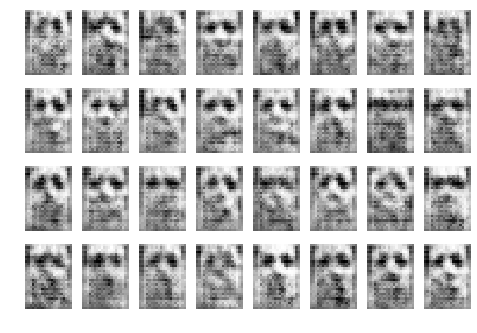


epoch 28: discriminator loss: 0.09	generator loss: 0.65


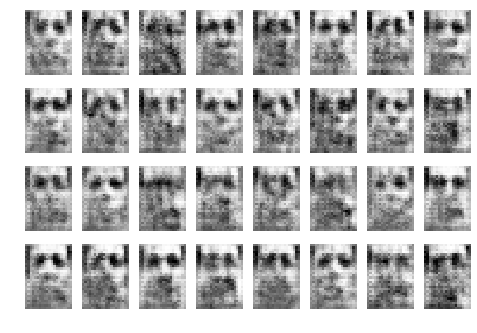


epoch 29: discriminator loss: 0.10	generator loss: 0.63


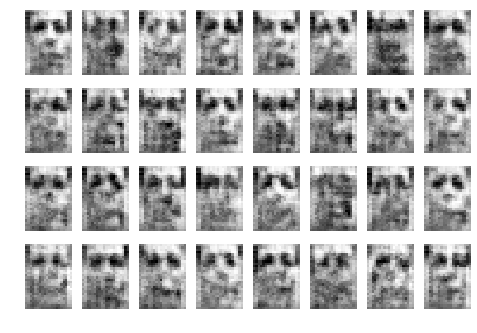


epoch 30: discriminator loss: 0.12	generator loss: 0.58


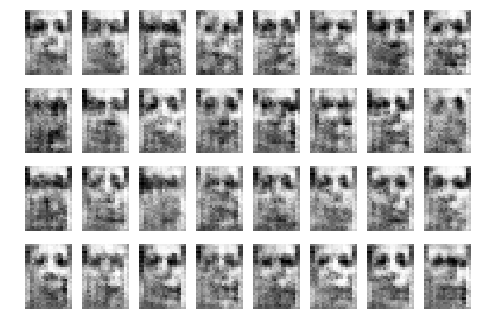


epoch 31: discriminator loss: 0.12	generator loss: 0.55


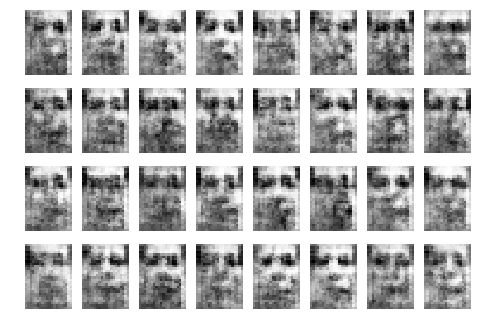


epoch 32: discriminator loss: 0.18	generator loss: 0.55


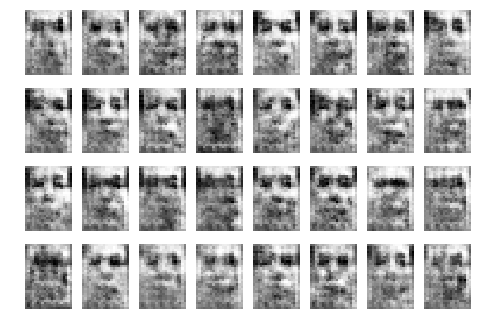


epoch 33: discriminator loss: 0.18	generator loss: 0.49


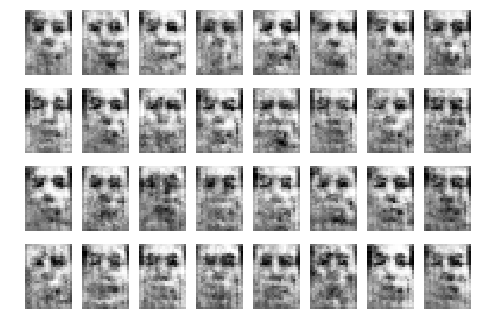


epoch 34: discriminator loss: 0.18	generator loss: 0.43


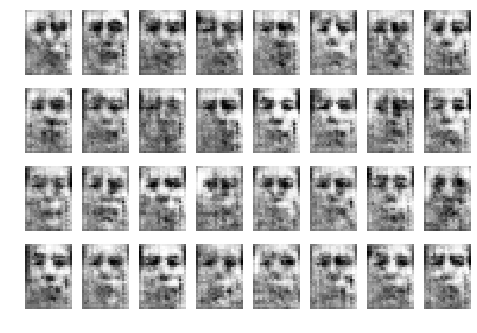


epoch 35: discriminator loss: 0.20	generator loss: 0.39


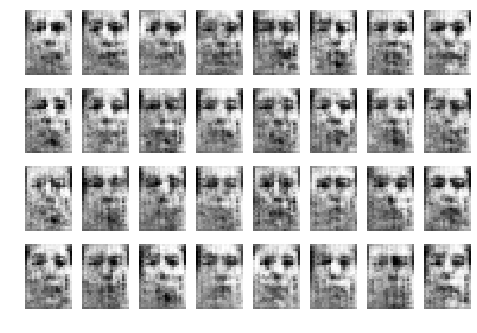


epoch 36: discriminator loss: 0.19	generator loss: 0.40


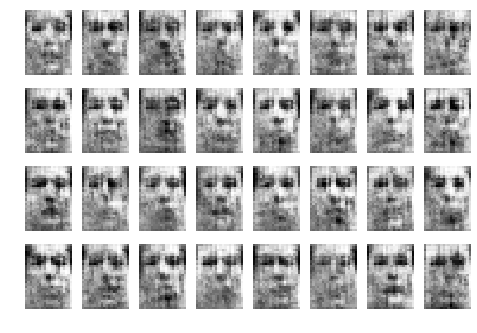


epoch 37: discriminator loss: 0.21	generator loss: 0.37


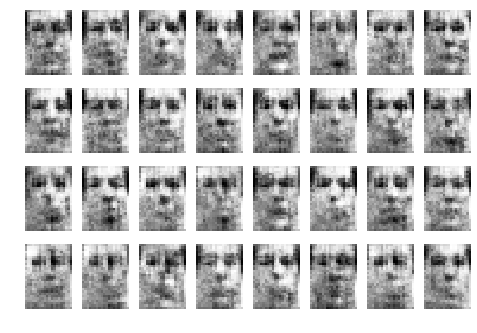


epoch 38: discriminator loss: 0.19	generator loss: 0.37


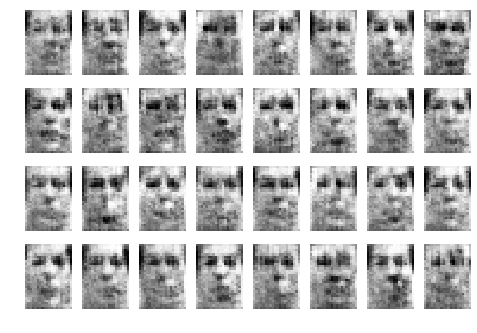


epoch 39: discriminator loss: 0.22	generator loss: 0.34


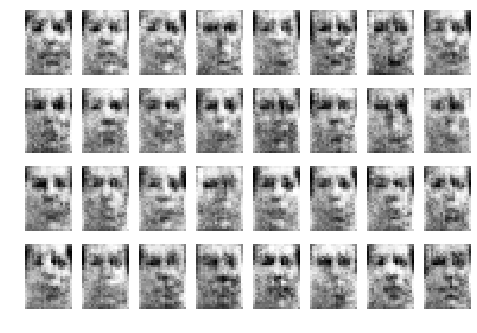


epoch 40: discriminator loss: 0.21	generator loss: 0.36


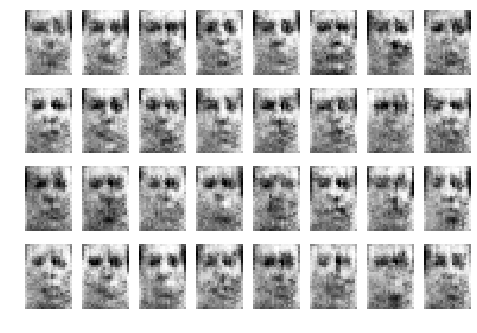


epoch 41: discriminator loss: 0.20	generator loss: 0.37


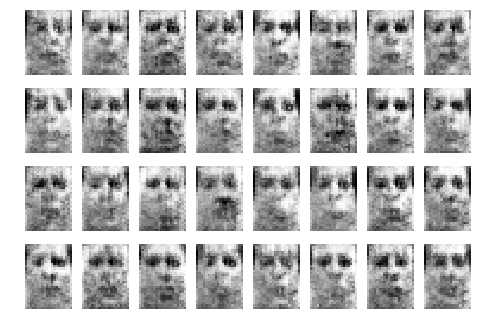


epoch 42: discriminator loss: 0.19	generator loss: 0.38


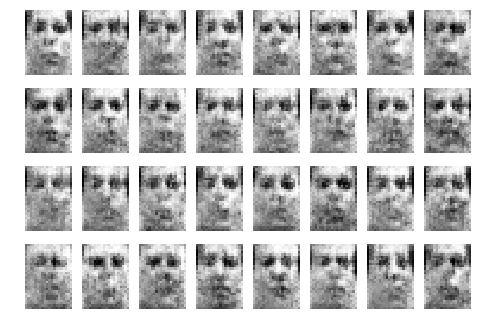


epoch 43: discriminator loss: 0.19	generator loss: 0.41


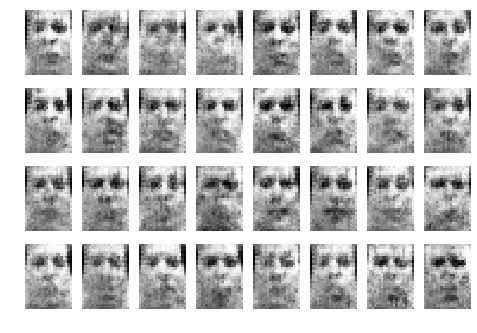


epoch 44: discriminator loss: 0.19	generator loss: 0.37


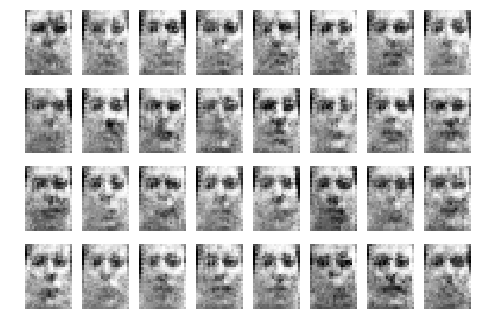


epoch 45: discriminator loss: 0.18	generator loss: 0.39


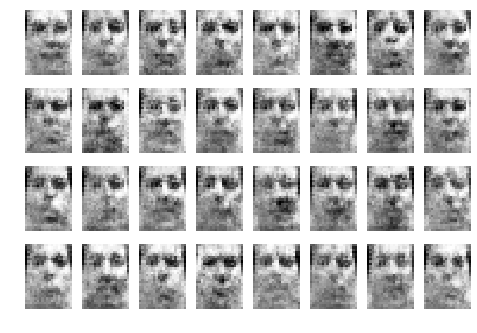


epoch 46: discriminator loss: 0.17	generator loss: 0.41


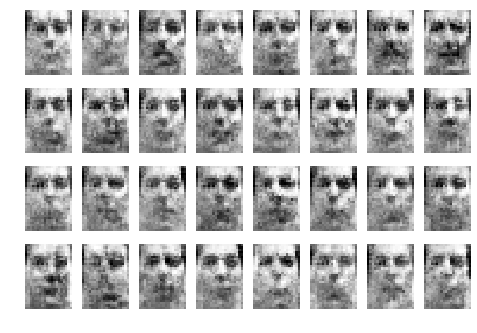


epoch 47: discriminator loss: 0.16	generator loss: 0.40


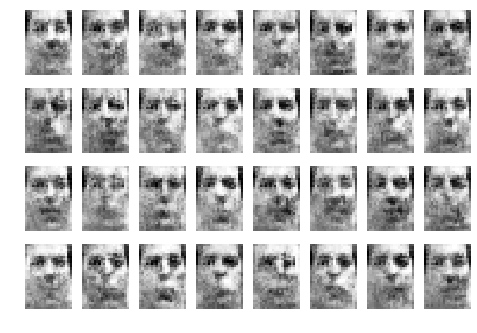


epoch 48: discriminator loss: 0.16	generator loss: 0.41


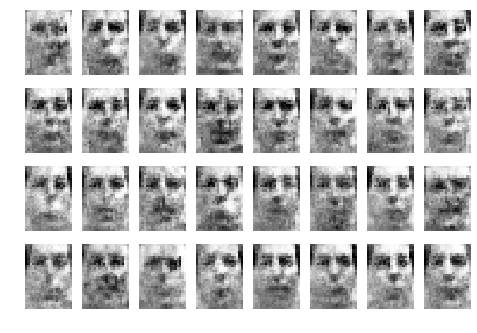


epoch 49: discriminator loss: 0.15	generator loss: 0.43


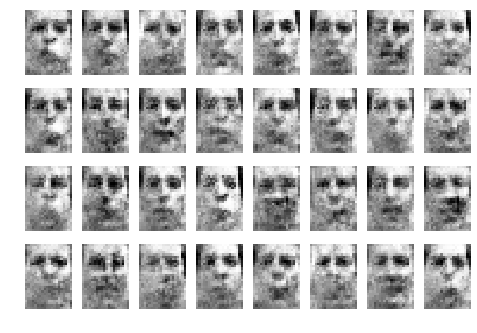


epoch 50: discriminator loss: 0.15	generator loss: 0.42


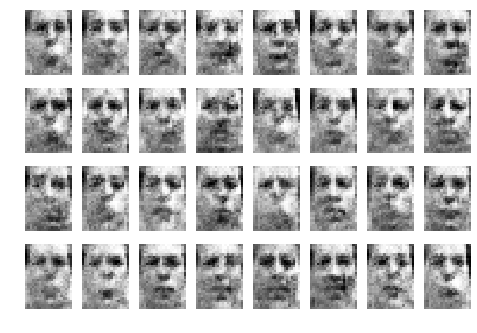


epoch 51: discriminator loss: 0.16	generator loss: 0.45


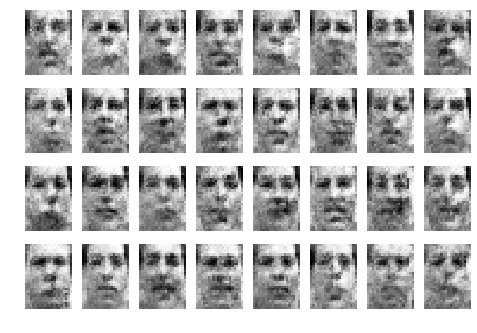


epoch 52: discriminator loss: 0.16	generator loss: 0.43


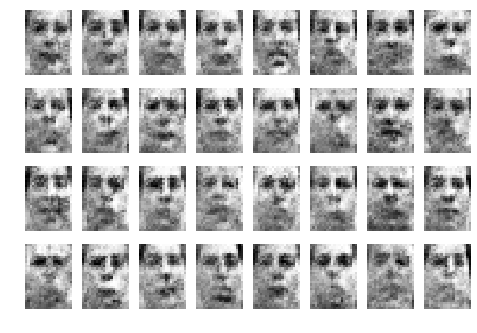


epoch 53: discriminator loss: 0.17	generator loss: 0.42


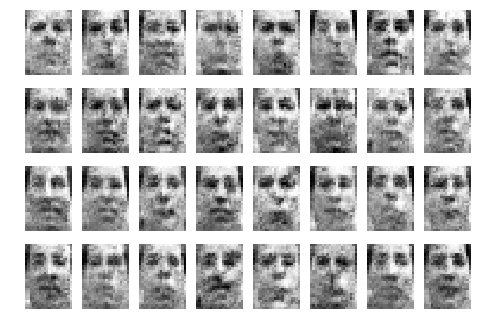


epoch 54: discriminator loss: 0.18	generator loss: 0.42


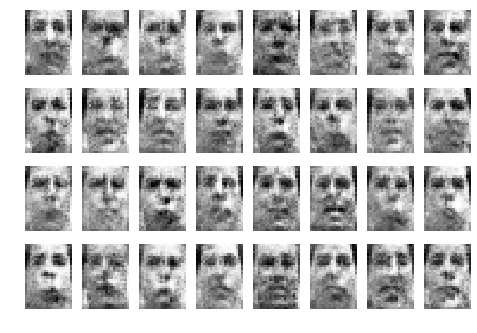


epoch 55: discriminator loss: 0.16	generator loss: 0.42


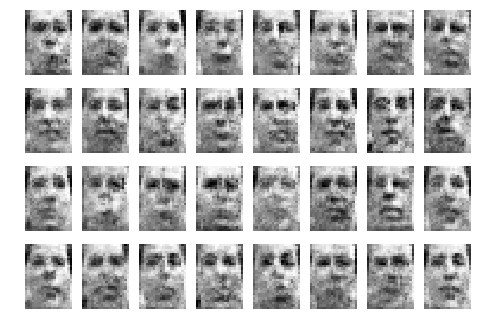


epoch 56: discriminator loss: 0.16	generator loss: 0.42


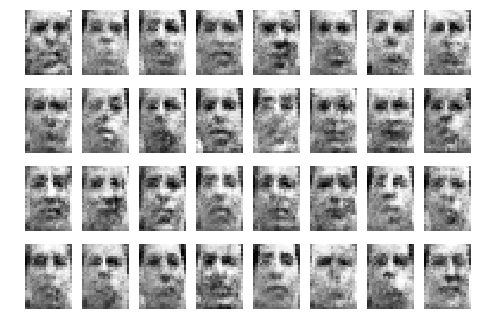


epoch 57: discriminator loss: 0.15	generator loss: 0.42


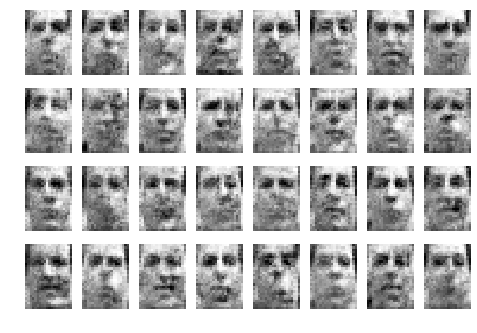


epoch 58: discriminator loss: 0.17	generator loss: 0.41


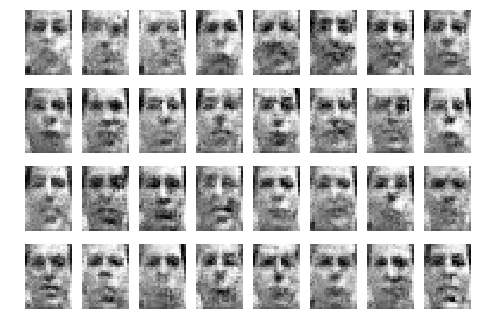


epoch 59: discriminator loss: 0.18	generator loss: 0.42


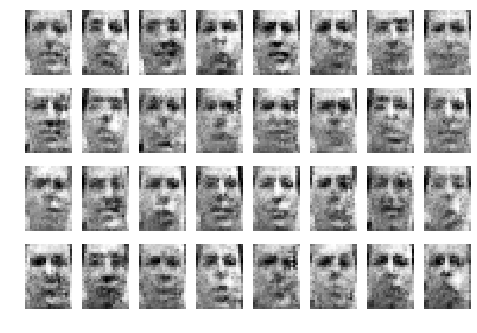


epoch 60: discriminator loss: 0.16	generator loss: 0.42


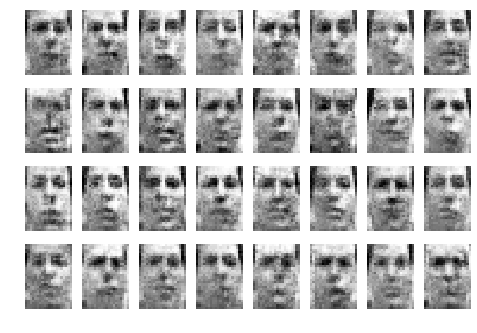


epoch 61: discriminator loss: 0.18	generator loss: 0.42


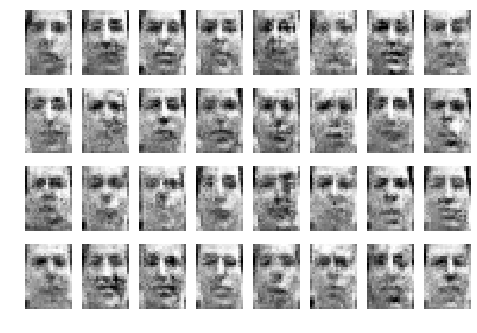


epoch 62: discriminator loss: 0.18	generator loss: 0.42


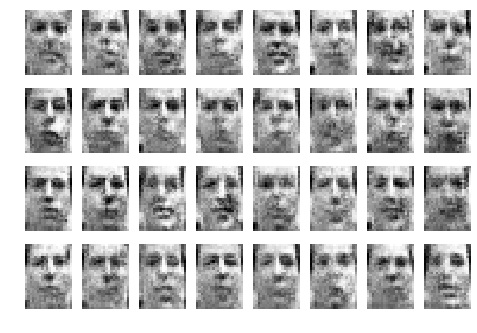


epoch 63: discriminator loss: 0.16	generator loss: 0.39


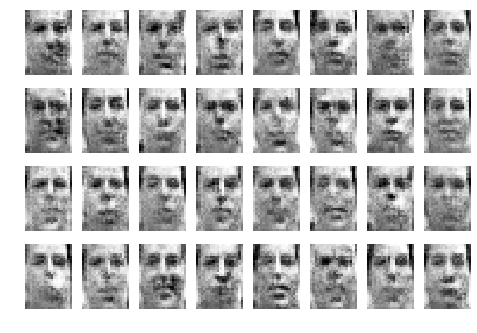


epoch 64: discriminator loss: 0.17	generator loss: 0.43


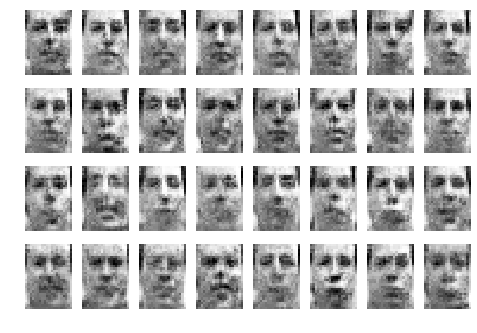


epoch 65: discriminator loss: 0.18	generator loss: 0.40


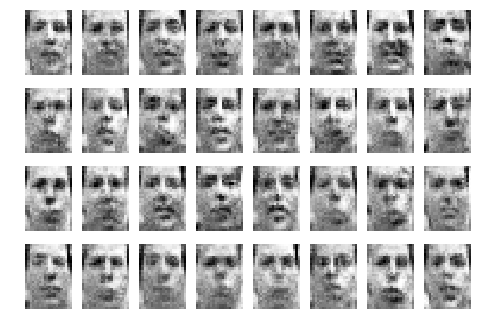


epoch 66: discriminator loss: 0.20	generator loss: 0.43


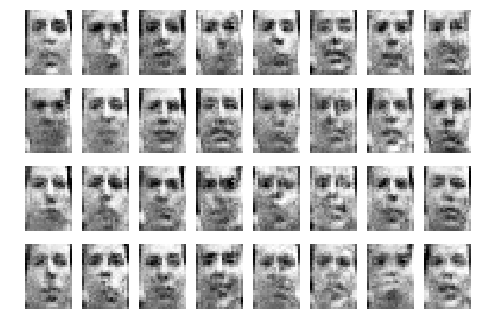


epoch 67: discriminator loss: 0.18	generator loss: 0.43


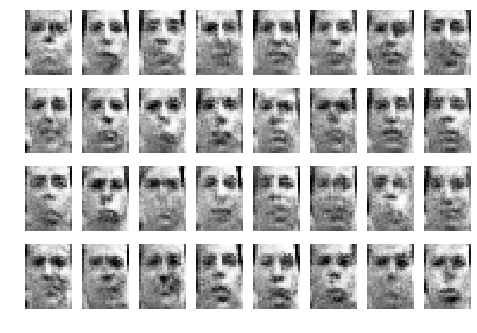


epoch 68: discriminator loss: 0.18	generator loss: 0.41


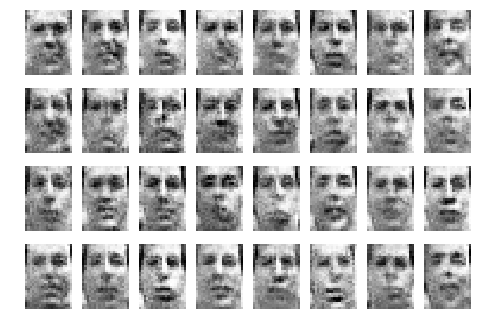


epoch 69: discriminator loss: 0.18	generator loss: 0.40


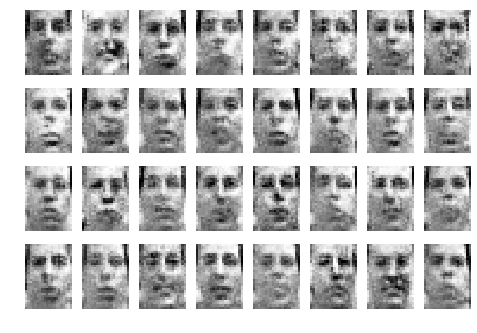


epoch 70: discriminator loss: 0.17	generator loss: 0.41


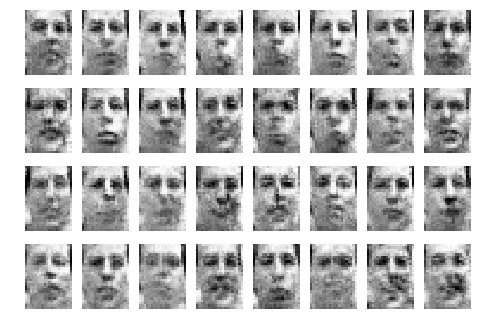


epoch 71: discriminator loss: 0.18	generator loss: 0.41


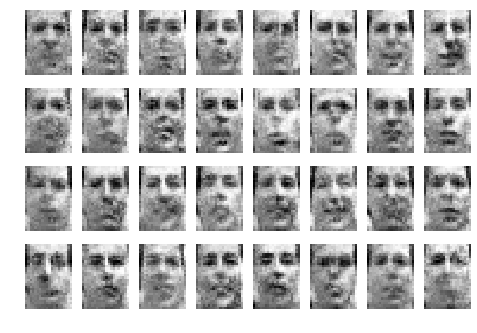


epoch 72: discriminator loss: 0.18	generator loss: 0.42


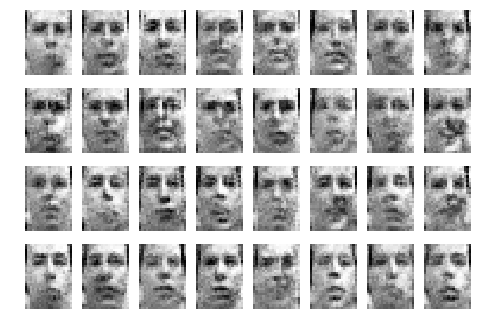


epoch 73: discriminator loss: 0.20	generator loss: 0.38


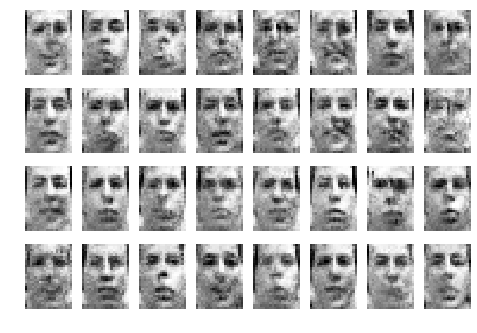


epoch 74: discriminator loss: 0.19	generator loss: 0.38


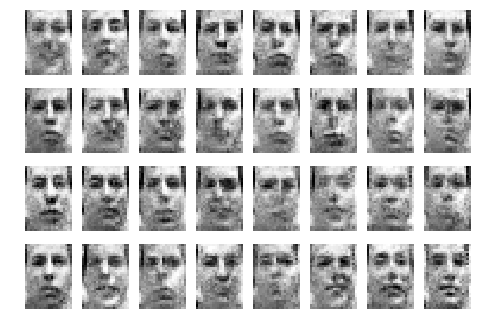


epoch 75: discriminator loss: 0.18	generator loss: 0.39


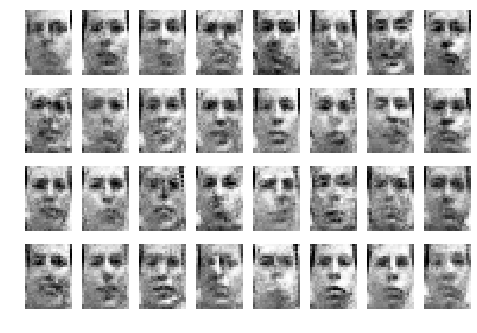


epoch 76: discriminator loss: 0.17	generator loss: 0.40


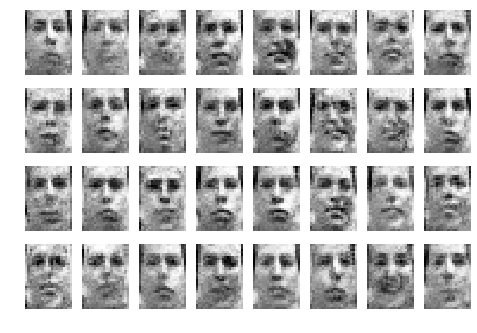


epoch 77: discriminator loss: 0.17	generator loss: 0.39


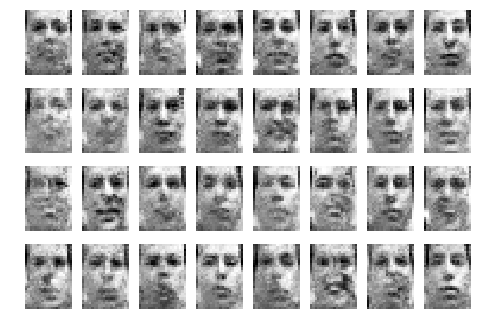


epoch 78: discriminator loss: 0.17	generator loss: 0.39


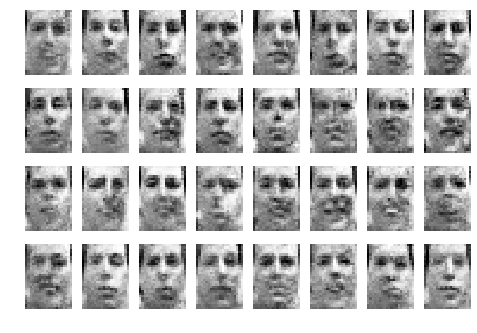


epoch 79: discriminator loss: 0.20	generator loss: 0.38


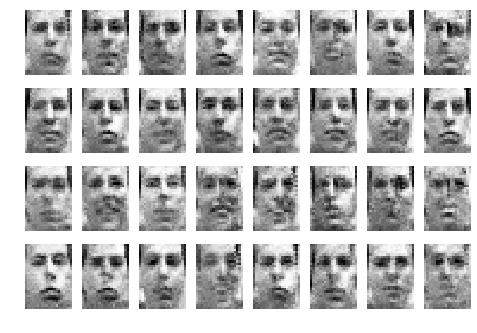


epoch 80: discriminator loss: 0.19	generator loss: 0.37


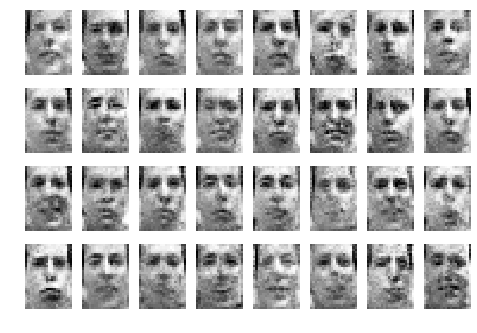


epoch 81: discriminator loss: 0.19	generator loss: 0.40


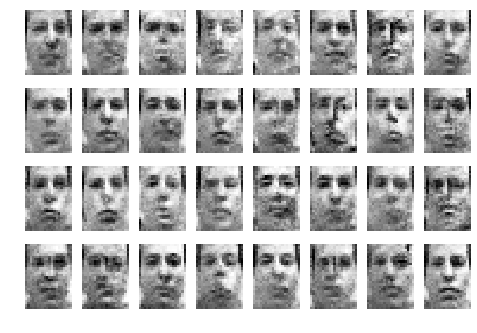


epoch 82: discriminator loss: 0.19	generator loss: 0.35


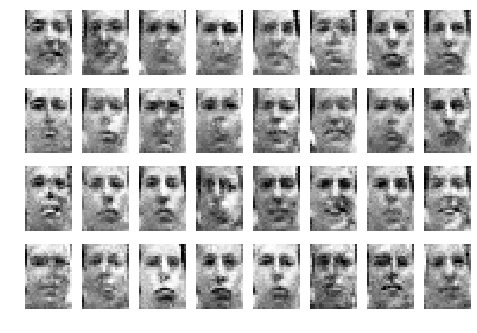


epoch 83: discriminator loss: 0.20	generator loss: 0.36


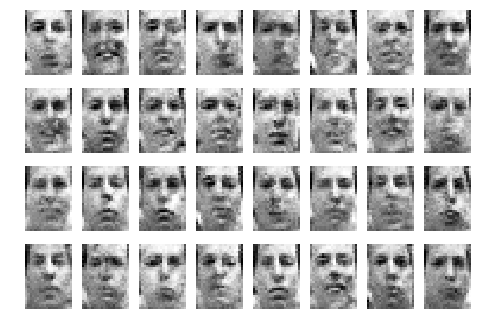


epoch 84: discriminator loss: 0.19	generator loss: 0.38


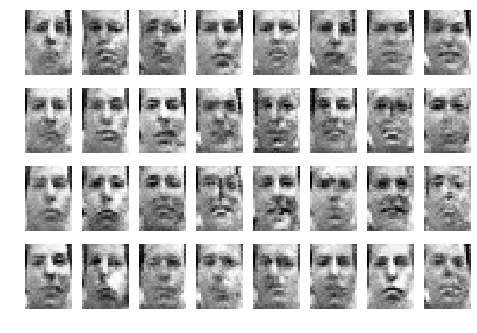


epoch 85: discriminator loss: 0.19	generator loss: 0.38


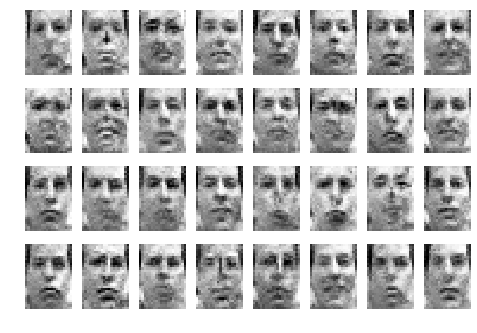


epoch 86: discriminator loss: 0.19	generator loss: 0.36


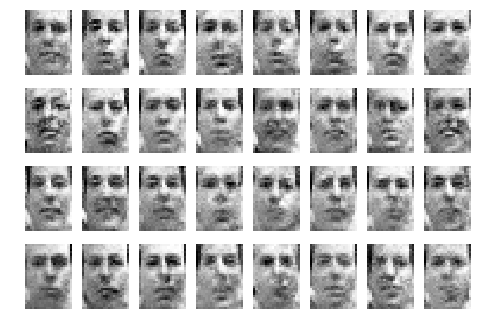


epoch 87: discriminator loss: 0.17	generator loss: 0.36


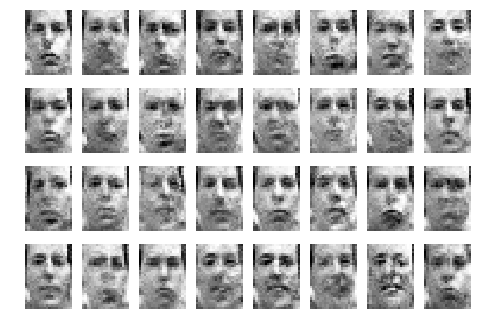


epoch 88: discriminator loss: 0.19	generator loss: 0.38


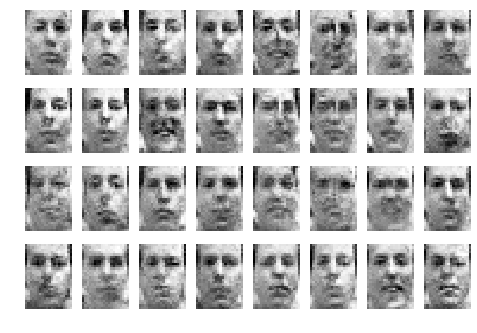


epoch 89: discriminator loss: 0.19	generator loss: 0.35


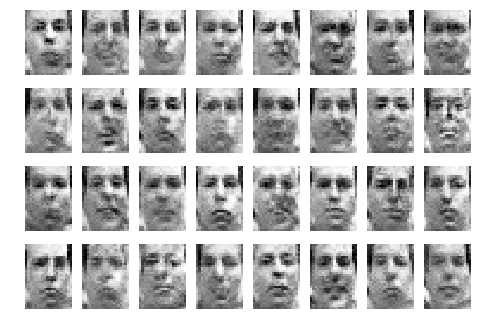


epoch 90: discriminator loss: 0.19	generator loss: 0.39


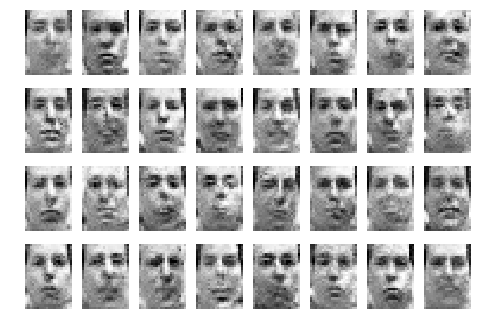


epoch 91: discriminator loss: 0.21	generator loss: 0.40


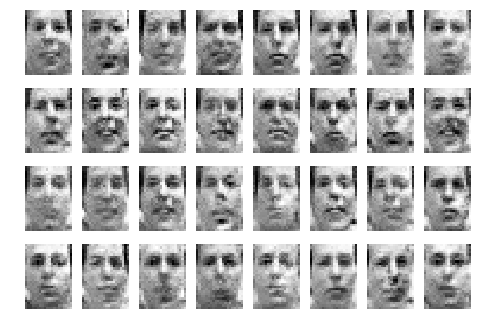


epoch 92: discriminator loss: 0.21	generator loss: 0.37


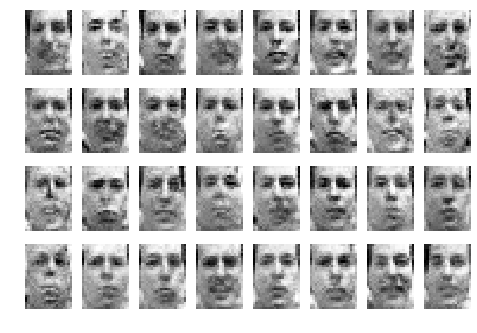


epoch 93: discriminator loss: 0.19	generator loss: 0.36


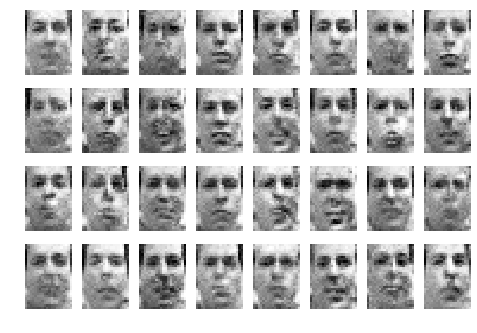


epoch 94: discriminator loss: 0.20	generator loss: 0.36


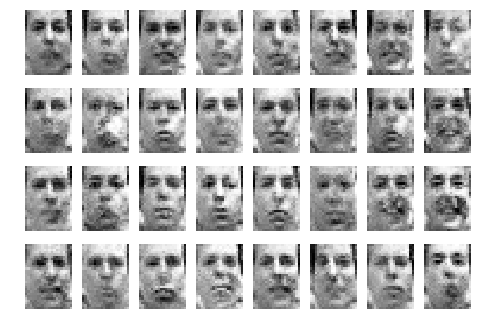


epoch 95: discriminator loss: 0.19	generator loss: 0.37


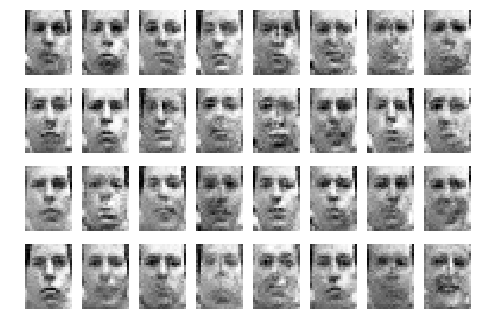


epoch 96: discriminator loss: 0.21	generator loss: 0.35


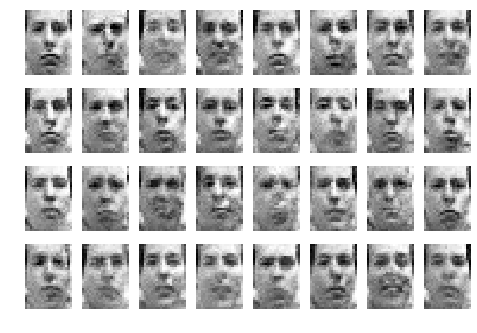


epoch 97: discriminator loss: 0.20	generator loss: 0.36


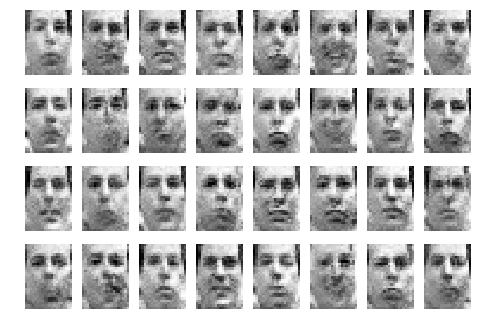


epoch 98: discriminator loss: 0.22	generator loss: 0.36


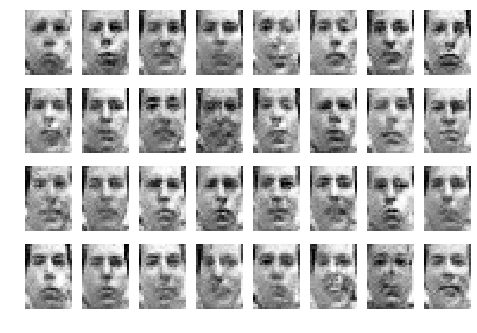


epoch 99: discriminator loss: 0.20	generator loss: 0.35


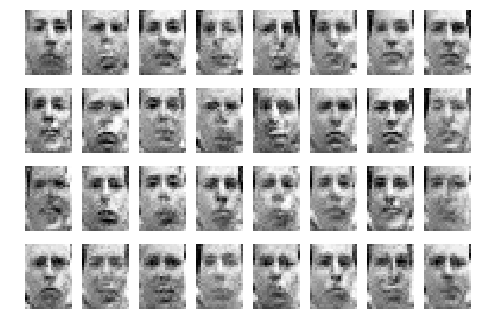


epoch 100: discriminator loss: 0.21	generator loss: 0.33


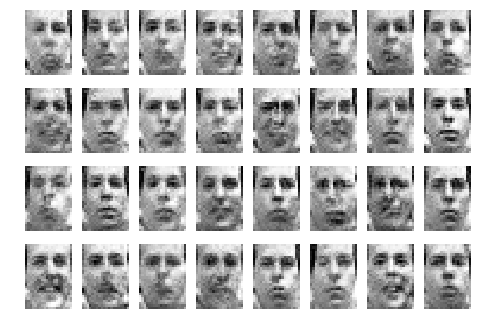

In [19]:
def get_generator():
  """ Builds the generator network that converts noise into images. """
  
   # Input is a 100-dimensional latent vector
  inputs = Input((100,))
  
  # Fully-connected layer to transform noise into a tensor
#   x = Dense(1024, activation='relu')(inputs)
#   x = Dense(1024, activation='relu')(x)
  
  x = Dense(7*5*64,activation='relu')(inputs) 

  x = Reshape((7,5,64))(x)
  
  # Transposed convolutions to upsample tensor
  x = Conv2DTranspose(32,4,strides=2,activation=None,padding='same')(x)
  x = LeakyReLU(alpha=0.1)(x)

  outputs = Conv2DTranspose(1,4,strides=2,activation='tanh',padding='same')(x)
  
  return Model(inputs=inputs,outputs=outputs)
   
def get_discriminator():
  """ Builds the discriminator network which tries to discriminate real images from fakes. """
  # Input is a 64x64 image
  inputs = Input((28,20,1))
  
  # Strided convolutions to downsample
  x = Conv2D(32,4,strides=2,activation=None,padding='same')(inputs)  
  x = LeakyReLU(alpha=0.1)(x)
  x = Conv2D(64,4,strides=2,activation=None,padding='same')(x)
  x = LeakyReLU(alpha=0.1)(x)

  # Final output with sigmoid activation for binary classification
  x = Flatten()(x)
  outputs = Dense(1,activation='sigmoid')(x)
  
  return Model(inputs=inputs,outputs=outputs)

def setup_gan_training(generator,discriminator):
  g_opt = Adam(lr=0.0002,beta_1=0.5,beta_2=0.999,epsilon=1e-3)
  d_opt = Adam(lr=0.0002,beta_1=0.5,beta_2=0.999,epsilon=1e-3)
#   d_opt = SGD(lr=0.0002, decay=1e-6, momentum=0.9, nesterov=True)

  generator.compile(loss='mean_squared_error',optimizer=g_opt)
  discriminator.compile(loss='mean_squared_error',optimizer=d_opt)

  discriminator.trainable = False
  inputs = Input((100,))
  x = generator(inputs)
  outputs = discriminator(x)
  
  d_on_g = Model(inputs=inputs,outputs=outputs)
  d_on_g.compile(loss='mean_squared_error',optimizer=g_opt)
  
  return d_on_g

def sample_from_generator(generator):
  noise_input = np.random.normal(size=(32,100))
  x_fake = np.squeeze(generator.predict(noise_input))
  n = 0
  for i in range(4):
    for j in range(8):
      plt.subplot(4,8,n+1)
      plt.imshow(x_fake[n])
      plt.axis('off')
      n = n+1
  plt.show()

def train_gan(generator, discriminator, d_on_g,
              x, num_epochs=100, batch_size=64):
  num_batches = len(x) // batch_size
    
  gen_loss_history = []
  discrim_loss_history = []
    
  for i in range(num_epochs):
    inds = np.arange(len(x))
    np.random.shuffle(inds)
        
    for j in trange(num_batches):
      noise_input = np.random.normal(size=(batch_size, 100))
            
      x_real = x[inds[(j*batch_size):((j+1)*batch_size)]]
      y_real = [1]*batch_size

      x_fake = generator.predict(noise_input, batch_size=batch_size)
      y_fake = [0]*batch_size

      discriminator.trainable = True
      for k in range(2):
        real_loss = discriminator.train_on_batch(x_real, y_real)
        fake_loss = discriminator.train_on_batch(x_fake, y_fake)
        discrim_loss = 0.5*(real_loss + fake_loss)
      
      # Train the generator once for every five times the descriminator is trained
      x_generator = np.random.normal(size=(batch_size, 100))
      y_generator = [1]*batch_size
      discriminator.trainable = False
      gen_loss = d_on_g.train_on_batch(x_generator, y_generator)
      gen_loss_history.append(gen_loss)
      
      discrim_loss_history.append(discrim_loss)
      
      
    print('epoch %d: discriminator loss: %.2f\tgenerator loss: %.2f'%(i+1,discrim_loss,gen_loss))
    sample_from_generator(generator)
    
  return gen_loss_history, discrim_loss_history

generator = get_generator()
discriminator = get_discriminator()
d_on_g = setup_gan_training(generator,discriminator)
gen_loss_history, discrim_loss_history = train_gan(generator,discriminator,d_on_g,x_train)

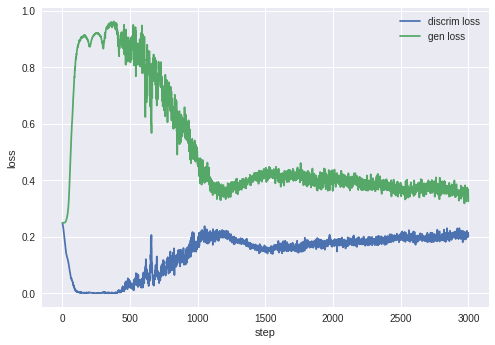

In [20]:
plt.plot(discrim_loss_history)
plt.plot(gen_loss_history)
plt.xlabel('step')
plt.ylabel('loss')
plt.legend(['discrim loss','gen loss'])
plt.show()

#### 4. Train a DCGAN on the LFW dataset and analyze the results. I put a loader below which resizes and crops to 28x20.

The results look like something from my nightmares.  One of them actually looks like Jabba the Hut from Star Wars, see: https://imgur.com/a/T9ZNj4u

On a more serous note, this datast took a lot longer to train because it had 7x more images. The sampled images don't look like the training set. Instead, features from different parts of the faces are being combined together. For example, many of the faces have eyes where one is wide open and the other is squinting. 

Additionally, the losses for the discriminator and the generator have converged at around 0.70. This did not happen with the previous dataset. This might be a result of using a dataset containing a variety of people because the training data is more diverse.

(13233, 28, 20)


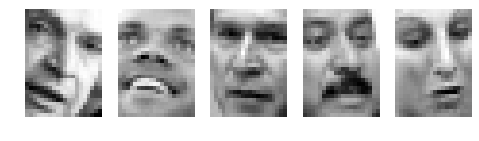

In [23]:
from tensorflow.keras.utils import get_file
import cv2
import glob

# download cropped images from LFW
path = get_file('lfwcrop_grey.zip','http://conradsanderson.id.au/lfwcrop/lfwcrop_grey.zip')

# unzip them
# !unzip /root/.keras/datasets/lfwcrop_grey.zip

# load all images
def load_and_crop(path):
  im = cv2.imread(path,0)
  im = cv2.resize(im,(28,28))
  im = im[:,4:-4]
  return im
images = np.stack([load_and_crop(path) for path in glob.glob('lfwcrop_grey/faces/*.pgm')])

# change to [-1 1] range
x_train = (images.astype('float32')/255.)*2-1
x_train = np.expand_dims(x_train,axis=-1)

# show images
print(images.shape)
for i in range(5):
  plt.subplot(1,5,i+1)
  plt.imshow(images[i])
  plt.axis('off')
plt.show()

In [0]:
def get_generator():
  """ Builds the generator network that converts noise into images. """
  
   # Input is a 100-dimensional latent vector
  inputs = Input((100,))
  x = Dense(7*5*64,activation='relu')(inputs) 

  x = Reshape((7,5,64))(x)
  
  # Transposed convolutions to upsample tensor
  x = Conv2DTranspose(32,4,strides=2,activation=None,padding='same')(x)
  x = LeakyReLU(alpha=0.1)(x)

  outputs = Conv2DTranspose(1,4,strides=2,activation='tanh',padding='same')(x)
  
  return Model(inputs=inputs,outputs=outputs)
   
def get_discriminator():
  """ Builds the discriminator network which tries to discriminate real images from fakes. """
  # Input is a 64x64 image
  inputs = Input((28,20,1))
  
  # Strided convolutions to downsample
  x = Conv2D(32,4,strides=2,activation=None,padding='same')(inputs)  
  x = LeakyReLU(alpha=0.1)(x)
  x = Conv2D(64,4,strides=2,activation=None,padding='same')(x)
  x = LeakyReLU(alpha=0.1)(x)

  # Final output with sigmoid activation for binary classification
  x = Flatten()(x)
  outputs = Dense(1,activation='sigmoid')(x)
  
  return Model(inputs=inputs,outputs=outputs)

def setup_gan_training(generator,discriminator):
  g_opt = Adam(lr=0.0002,beta_1=0.5,beta_2=0.999,epsilon=1e-3)
  d_opt = Adam(lr=0.0002,beta_1=0.5,beta_2=0.999,epsilon=1e-3)

  generator.compile(loss='binary_crossentropy',optimizer=g_opt)
  discriminator.compile(loss='binary_crossentropy',optimizer=d_opt)

  discriminator.trainable = False
  inputs = Input((100,))
  x = generator(inputs)
  outputs = discriminator(x)
  
  d_on_g = Model(inputs=inputs,outputs=outputs)
  d_on_g.compile(loss='binary_crossentropy',optimizer=g_opt)
  
  return d_on_g

def sample_from_generator(generator):
  noise_input = np.random.normal(size=(32,100))
  x_fake = np.squeeze(generator.predict(noise_input))
  n = 0
  for i in range(4):
    for j in range(8):
      plt.subplot(4,8,n+1)
      plt.imshow(x_fake[n])
      plt.axis('off')
      n = n+1
  plt.show()

def train_gan(generator, discriminator, d_on_g,
              x, num_epochs=100, batch_size=64):
  num_batches = len(x) // batch_size
    
  gen_loss_history = []
  discrim_loss_history = []
    
  for i in range(num_epochs):
    inds = np.arange(len(x))
    np.random.shuffle(inds)
        
    for j in trange(num_batches):
      noise_input = np.random.normal(size=(batch_size, 100))
            
      x_real = x[inds[(j*batch_size):((j+1)*batch_size)]]
      y_real = [1]*batch_size

      x_fake = generator.predict(noise_input, batch_size=batch_size)
      y_fake = [0]*batch_size

      discriminator.trainable = True
      real_loss = discriminator.train_on_batch(x_real, y_real)
      fake_loss = discriminator.train_on_batch(x_fake, y_fake)
      discrim_loss = 0.5*(real_loss + fake_loss)
      
      # Train the generator once for every five times the descriminator is trained
      x_generator = np.random.normal(size=(batch_size, 100))
      y_generator = [1]*batch_size
      discriminator.trainable = False
      gen_loss = d_on_g.train_on_batch(x_generator, y_generator)
      gen_loss_history.append(gen_loss)
      
      discrim_loss_history.append(discrim_loss)
      
      
    print('epoch %d: discriminator loss: %.2f\tgenerator loss: %.2f'%(i+1,discrim_loss,gen_loss))
    sample_from_generator(generator)
    
  return gen_loss_history, discrim_loss_history

generator = get_generator()
discriminator = get_discriminator()
d_on_g = setup_gan_training(generator,discriminator)


epoch 1: discriminator loss: 0.21	generator loss: 1.38


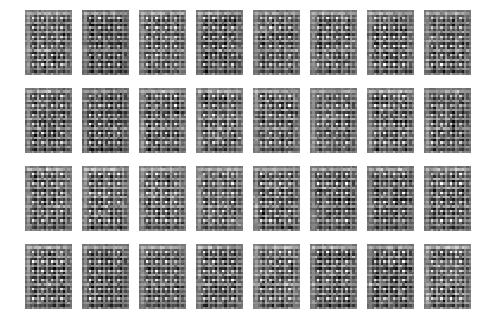


epoch 2: discriminator loss: 0.71	generator loss: 1.27


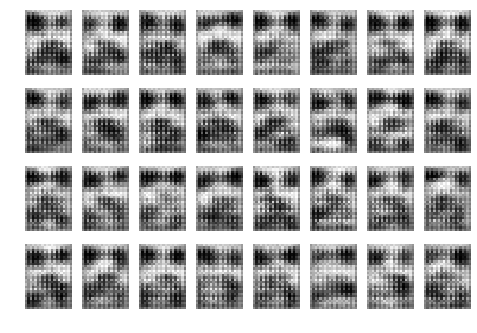


epoch 3: discriminator loss: 0.54	generator loss: 1.26


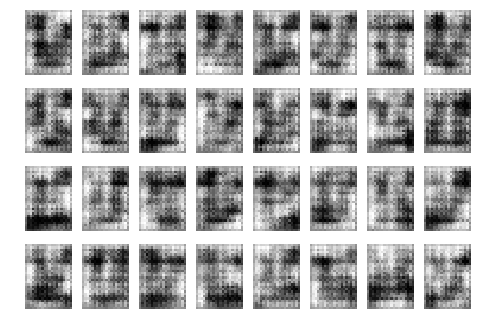


epoch 4: discriminator loss: 0.62	generator loss: 0.89


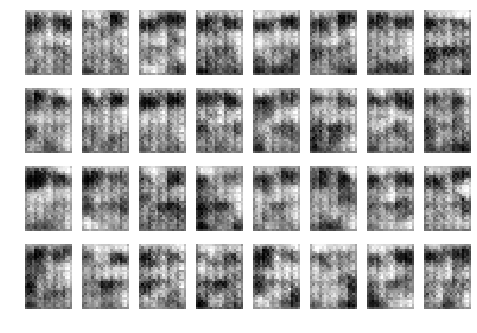


epoch 5: discriminator loss: 0.67	generator loss: 0.76


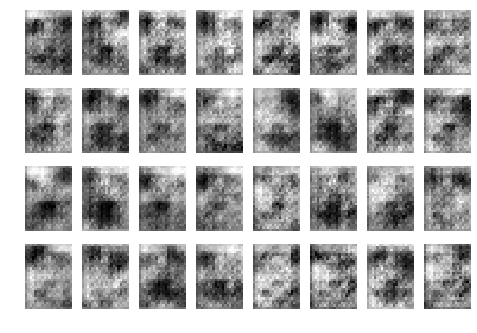


epoch 6: discriminator loss: 0.69	generator loss: 0.75


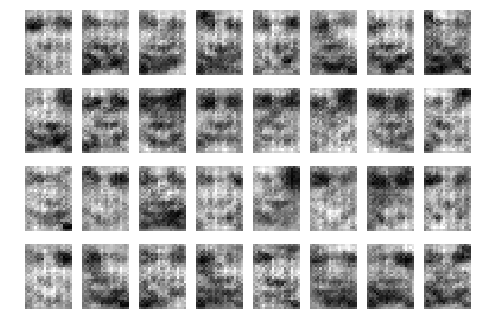


epoch 7: discriminator loss: 0.63	generator loss: 0.80


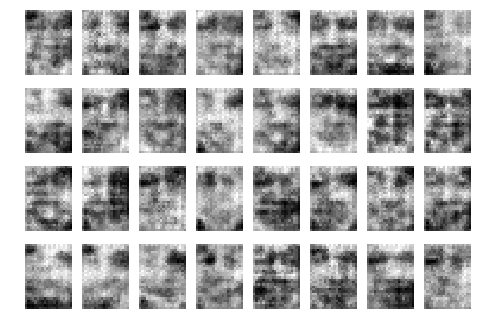


epoch 8: discriminator loss: 0.71	generator loss: 0.76


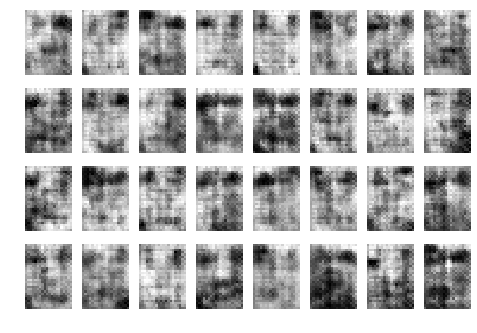


epoch 9: discriminator loss: 0.70	generator loss: 0.68


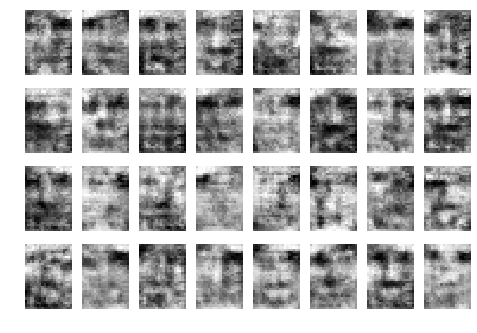


epoch 10: discriminator loss: 0.73	generator loss: 0.73


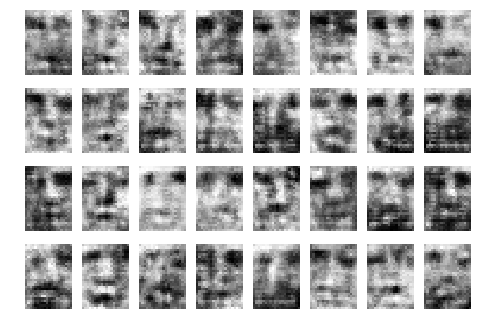


epoch 11: discriminator loss: 0.69	generator loss: 0.74


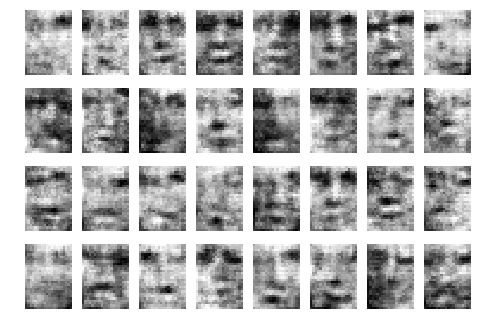


epoch 12: discriminator loss: 0.70	generator loss: 0.71


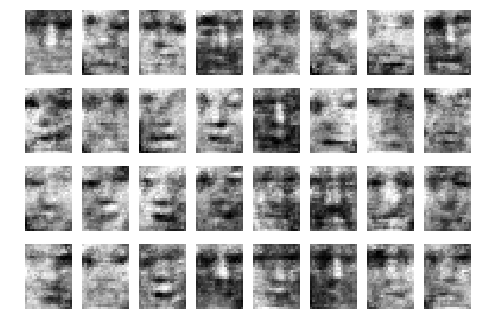


epoch 13: discriminator loss: 0.68	generator loss: 0.72


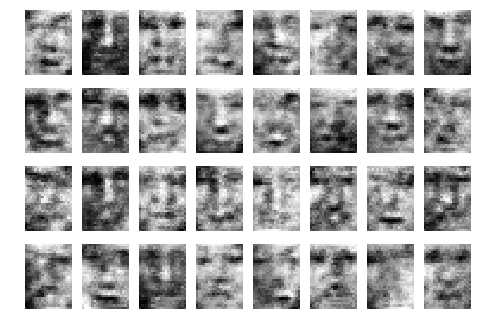


epoch 14: discriminator loss: 0.68	generator loss: 0.74


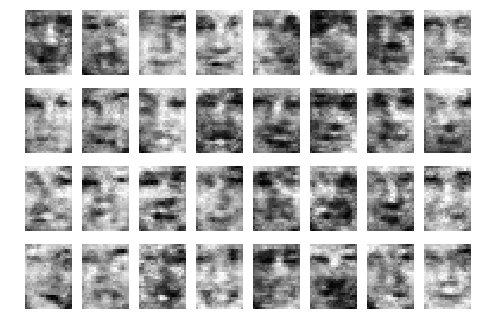


epoch 15: discriminator loss: 0.71	generator loss: 0.70


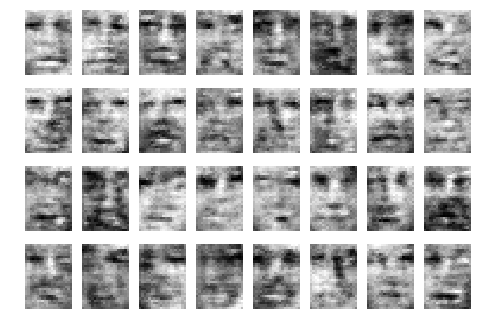


epoch 16: discriminator loss: 0.70	generator loss: 0.71


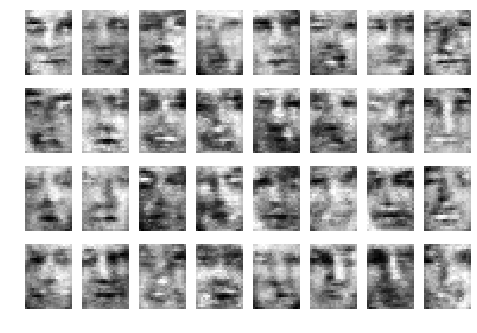


epoch 17: discriminator loss: 0.71	generator loss: 0.72


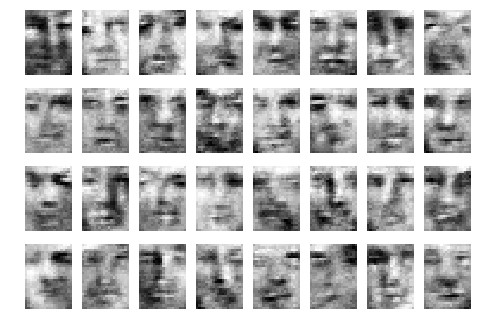


epoch 18: discriminator loss: 0.70	generator loss: 0.69


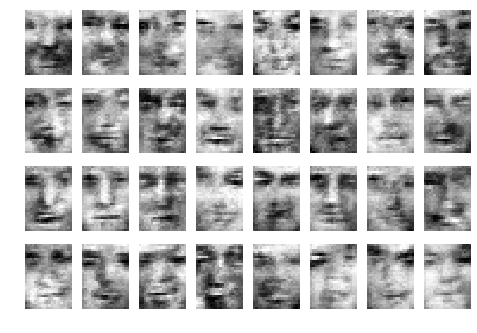


epoch 19: discriminator loss: 0.70	generator loss: 0.70


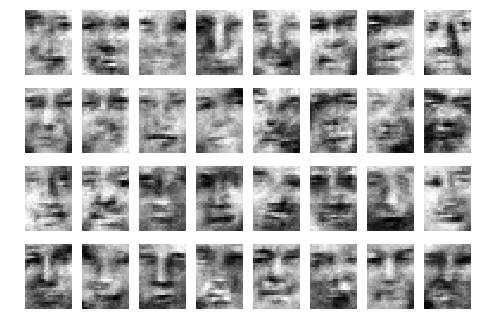


epoch 20: discriminator loss: 0.70	generator loss: 0.70


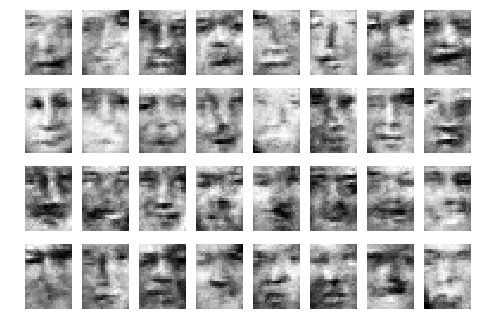


epoch 21: discriminator loss: 0.70	generator loss: 0.70


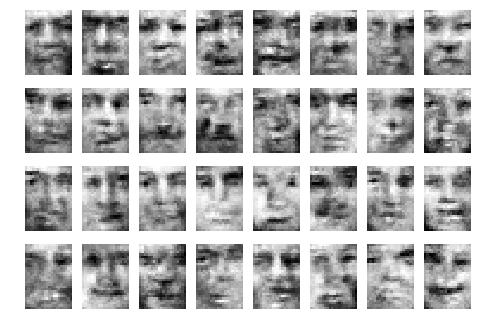


epoch 22: discriminator loss: 0.70	generator loss: 0.70


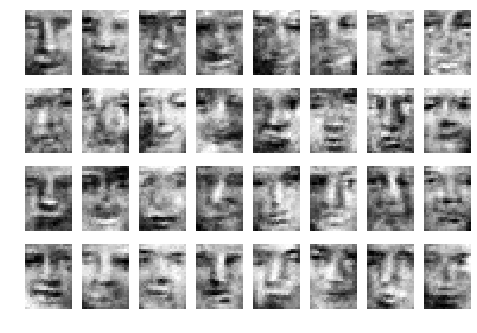


epoch 23: discriminator loss: 0.69	generator loss: 0.74


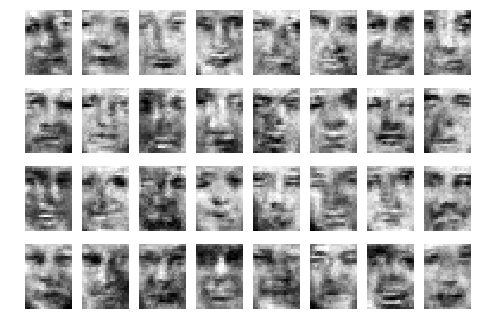


epoch 24: discriminator loss: 0.71	generator loss: 0.68


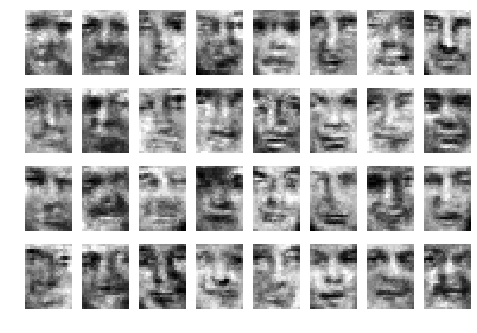


epoch 25: discriminator loss: 0.69	generator loss: 0.71


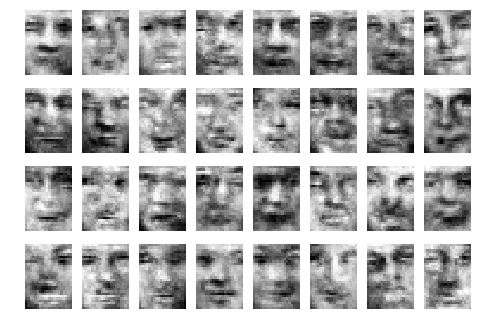


epoch 26: discriminator loss: 0.69	generator loss: 0.70


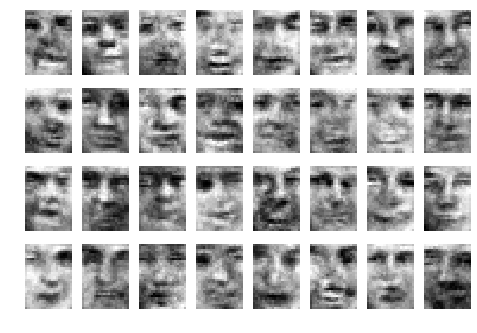


epoch 27: discriminator loss: 0.69	generator loss: 0.72


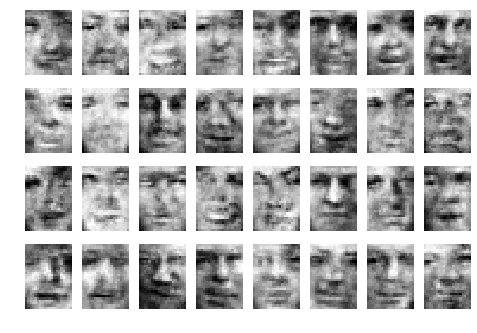


epoch 28: discriminator loss: 0.68	generator loss: 0.73


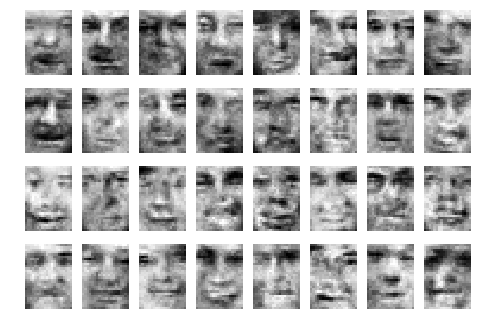


epoch 29: discriminator loss: 0.70	generator loss: 0.70


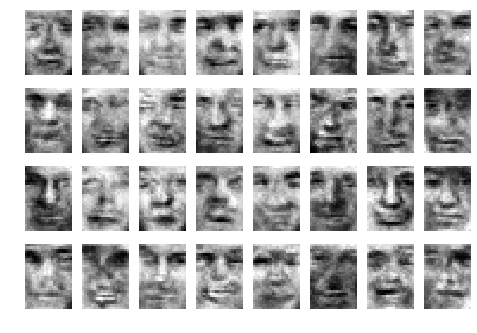


epoch 30: discriminator loss: 0.68	generator loss: 0.71


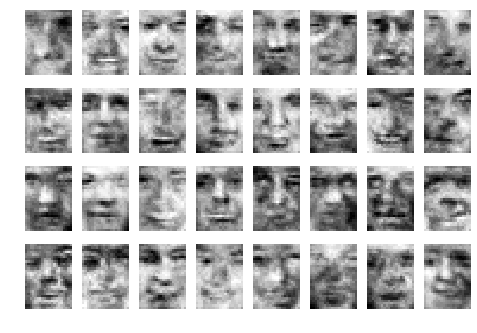


epoch 31: discriminator loss: 0.67	generator loss: 0.72


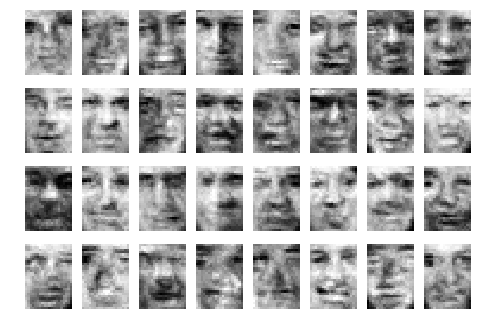


epoch 32: discriminator loss: 0.67	generator loss: 0.73


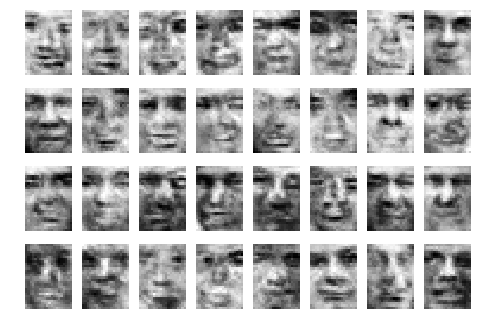


epoch 33: discriminator loss: 0.85	generator loss: 0.56


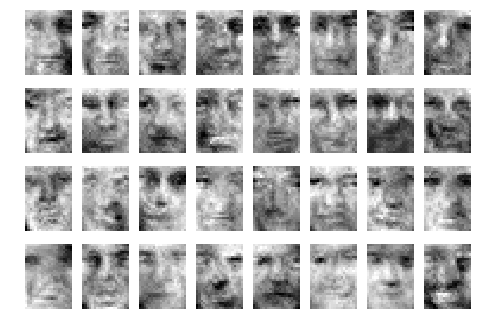


epoch 34: discriminator loss: 0.66	generator loss: 0.91


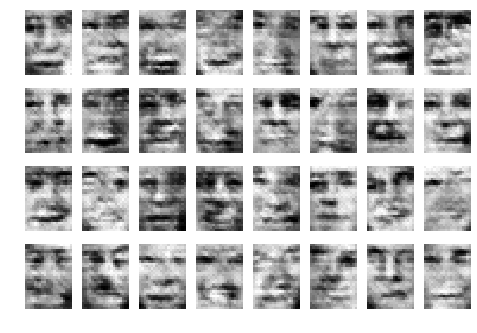


epoch 35: discriminator loss: 0.68	generator loss: 0.70


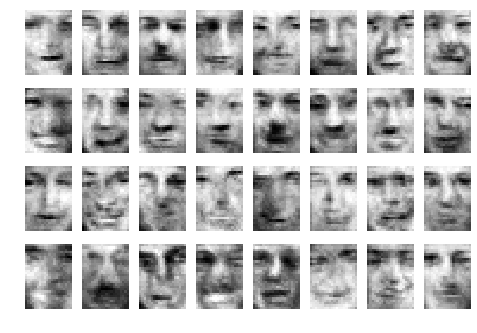


epoch 36: discriminator loss: 0.69	generator loss: 0.69


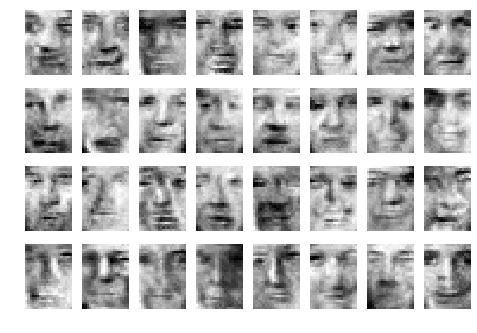


epoch 37: discriminator loss: 0.68	generator loss: 0.75


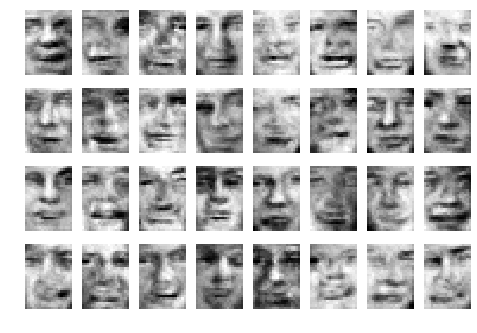


epoch 38: discriminator loss: 0.66	generator loss: 0.76


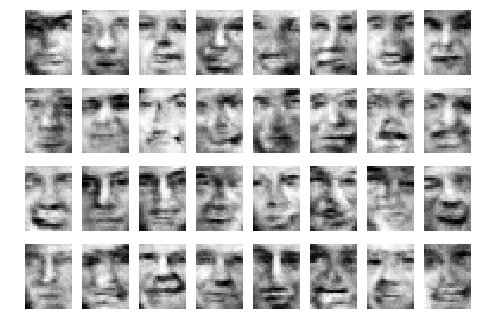


epoch 39: discriminator loss: 0.67	generator loss: 0.73


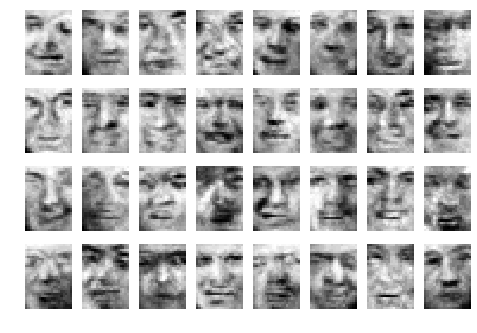


epoch 40: discriminator loss: 0.69	generator loss: 0.71


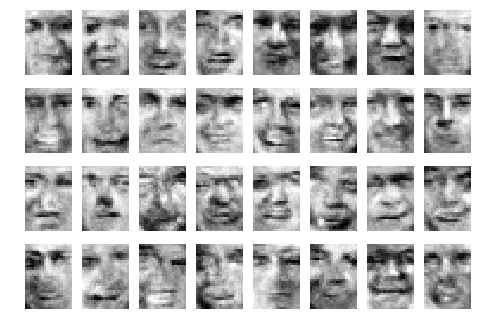


epoch 41: discriminator loss: 0.68	generator loss: 0.73


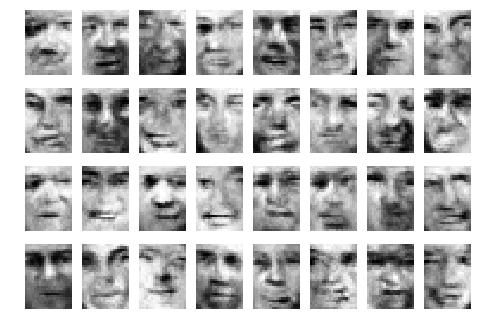


epoch 42: discriminator loss: 0.68	generator loss: 0.73


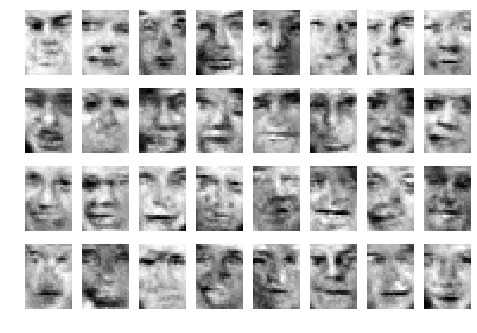


epoch 43: discriminator loss: 0.71	generator loss: 0.66


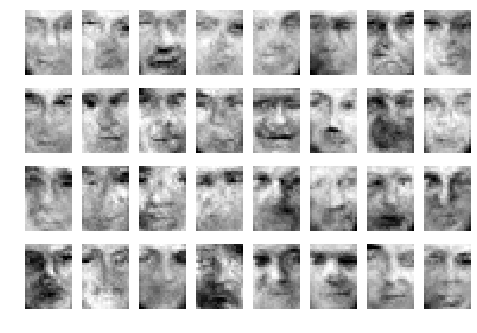


epoch 44: discriminator loss: 0.72	generator loss: 0.65


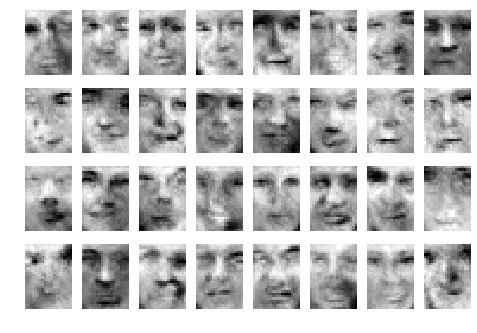


epoch 45: discriminator loss: 0.68	generator loss: 0.78


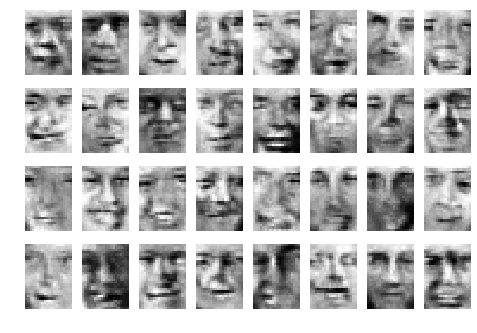


epoch 46: discriminator loss: 0.68	generator loss: 0.73


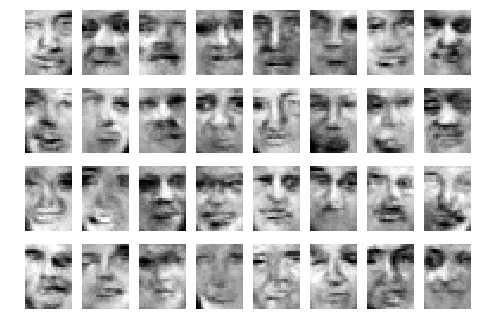


epoch 47: discriminator loss: 0.69	generator loss: 0.68


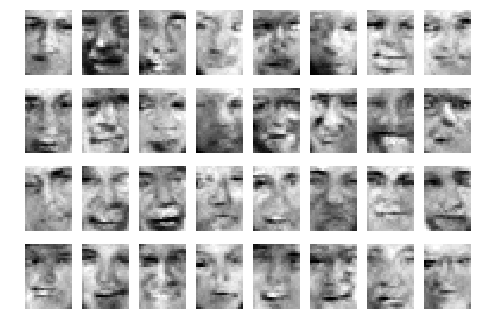


epoch 48: discriminator loss: 0.69	generator loss: 0.72


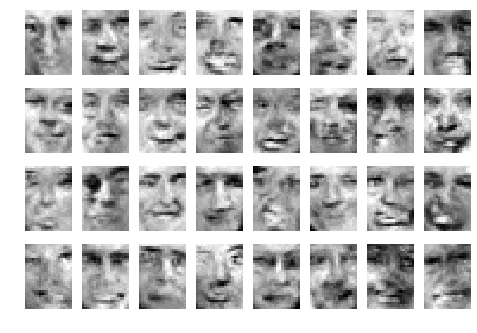


epoch 49: discriminator loss: 0.69	generator loss: 0.72


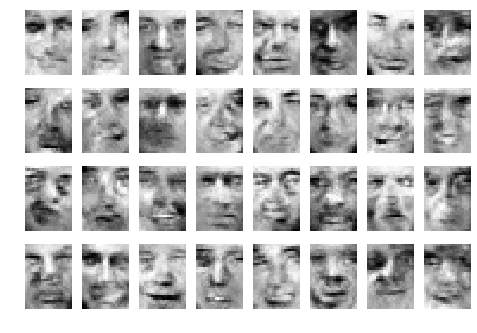


epoch 50: discriminator loss: 0.69	generator loss: 0.71


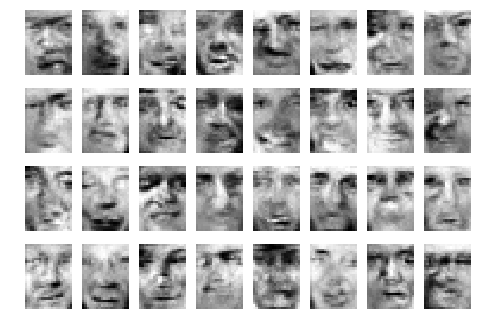


epoch 51: discriminator loss: 0.68	generator loss: 0.71


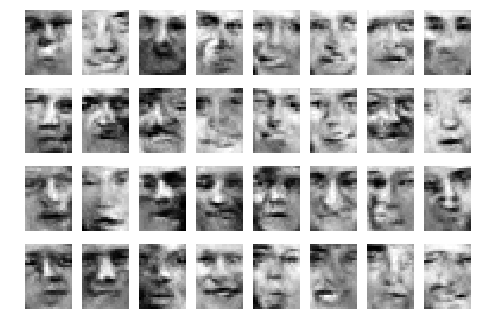


epoch 52: discriminator loss: 0.69	generator loss: 0.72


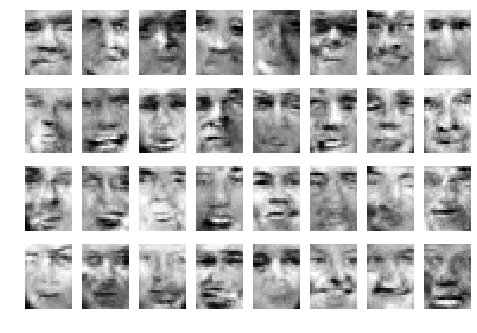


epoch 53: discriminator loss: 0.68	generator loss: 0.72


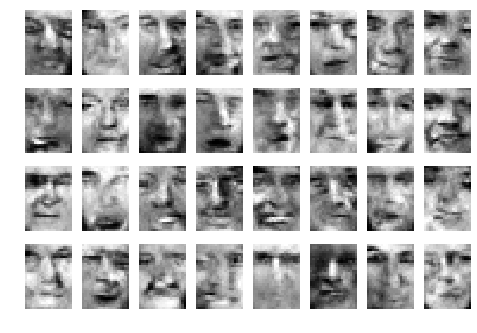


epoch 54: discriminator loss: 0.68	generator loss: 0.72


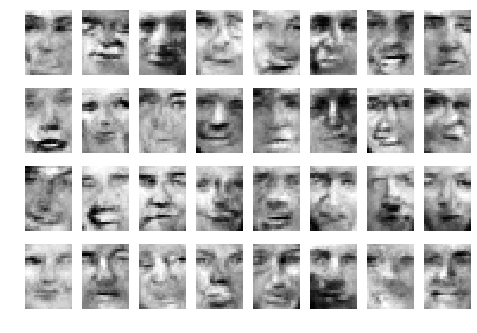


epoch 55: discriminator loss: 0.69	generator loss: 0.70


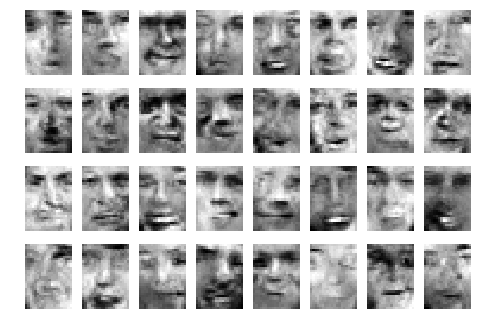


epoch 56: discriminator loss: 0.68	generator loss: 0.71


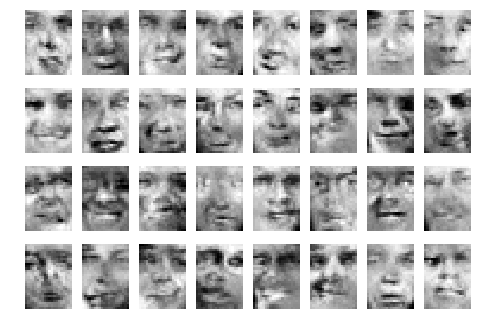


epoch 57: discriminator loss: 0.68	generator loss: 0.71


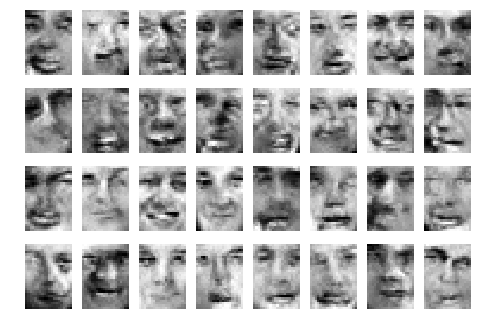


epoch 58: discriminator loss: 0.69	generator loss: 0.71


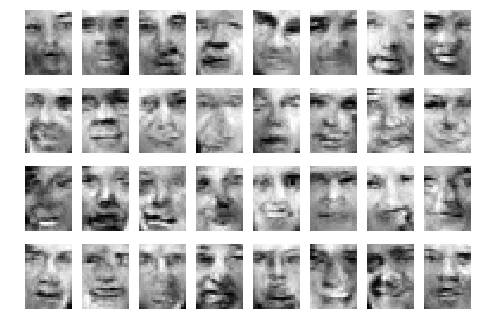


epoch 59: discriminator loss: 0.69	generator loss: 0.71


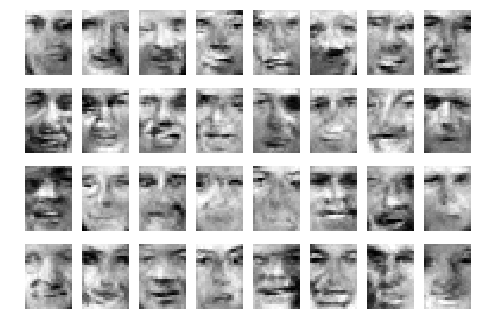


epoch 60: discriminator loss: 0.68	generator loss: 0.70


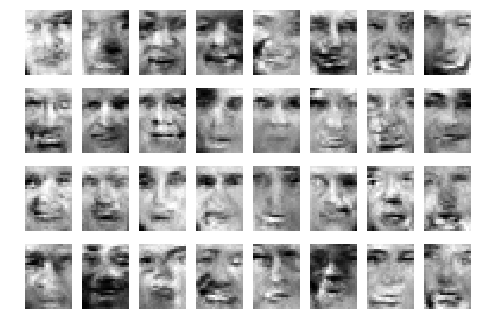


epoch 61: discriminator loss: 0.69	generator loss: 0.71


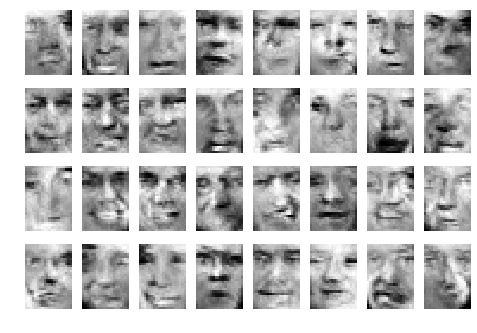


epoch 62: discriminator loss: 0.68	generator loss: 0.69


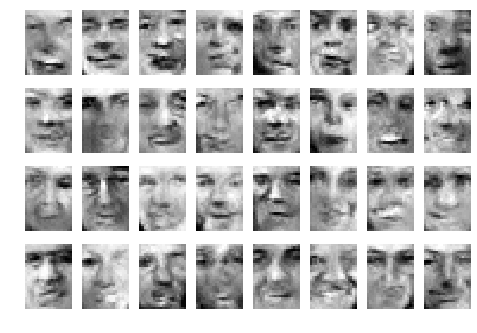


epoch 63: discriminator loss: 0.68	generator loss: 0.71


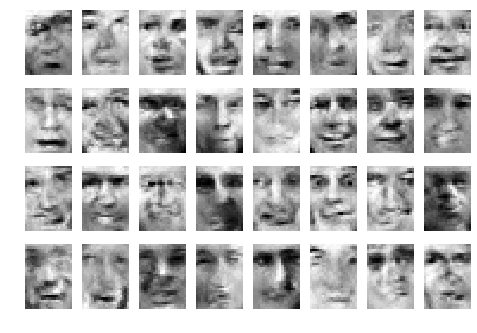


epoch 64: discriminator loss: 0.68	generator loss: 0.71


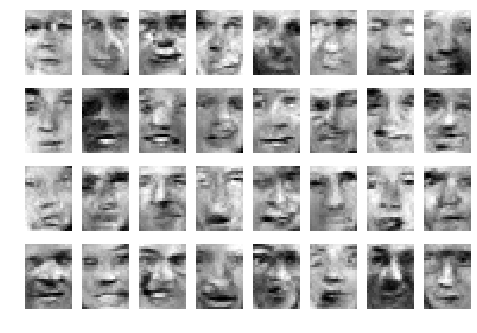


epoch 65: discriminator loss: 0.68	generator loss: 0.73


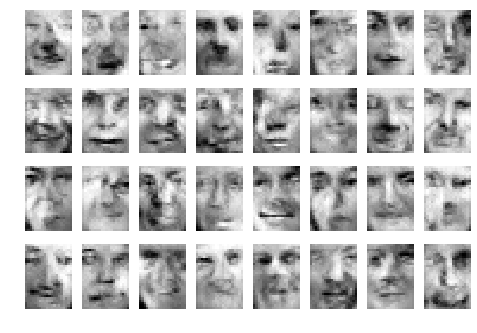


epoch 66: discriminator loss: 0.64	generator loss: 0.88


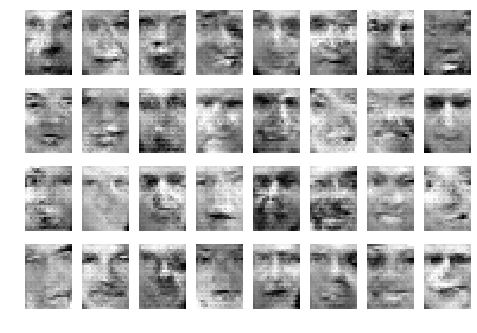


epoch 67: discriminator loss: 0.69	generator loss: 0.72


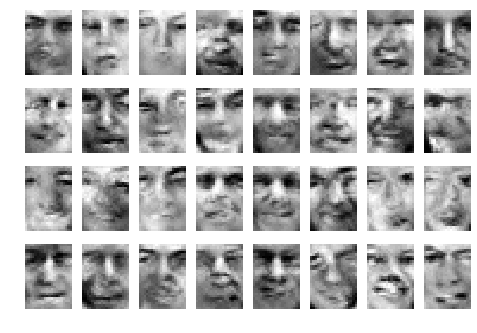


epoch 68: discriminator loss: 0.68	generator loss: 0.71


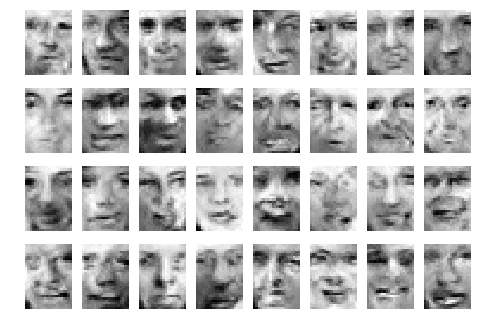


epoch 69: discriminator loss: 0.68	generator loss: 0.70


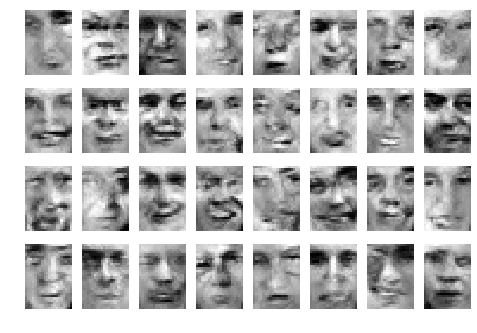


epoch 70: discriminator loss: 0.68	generator loss: 0.71


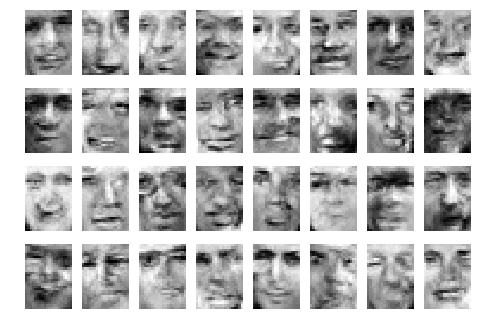


epoch 71: discriminator loss: 0.68	generator loss: 0.71


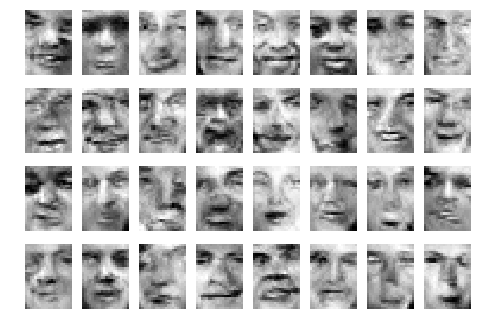


epoch 72: discriminator loss: 0.69	generator loss: 0.71


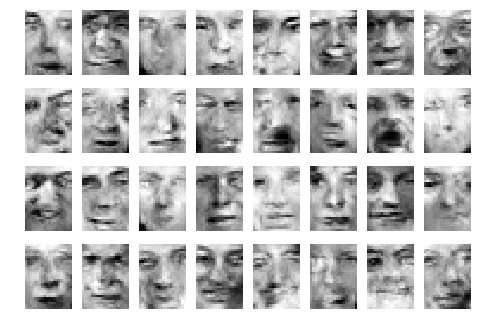


epoch 73: discriminator loss: 0.69	generator loss: 0.71


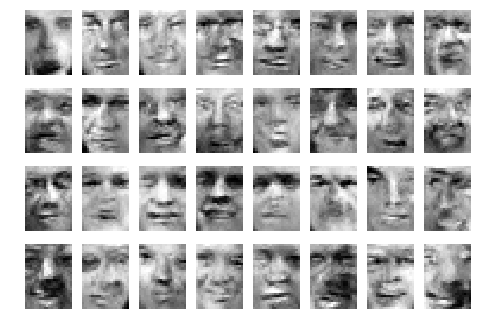


epoch 74: discriminator loss: 0.69	generator loss: 0.71


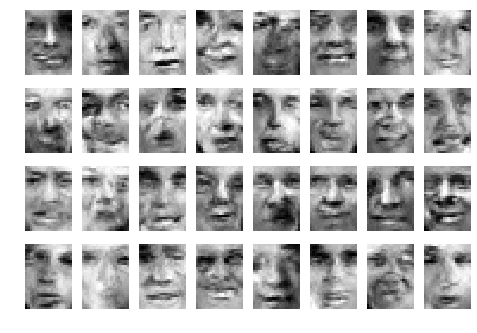


epoch 75: discriminator loss: 0.69	generator loss: 0.72


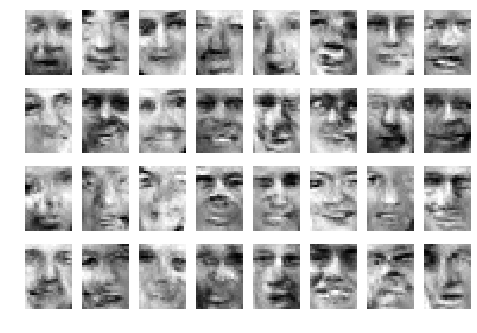


epoch 76: discriminator loss: 0.68	generator loss: 0.69


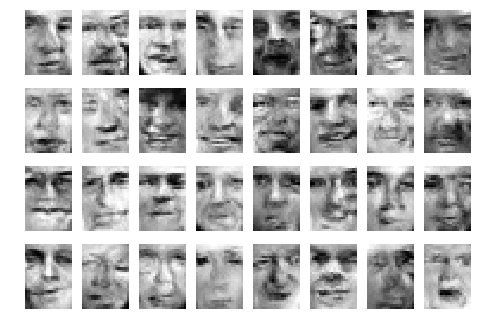


epoch 77: discriminator loss: 0.69	generator loss: 0.71


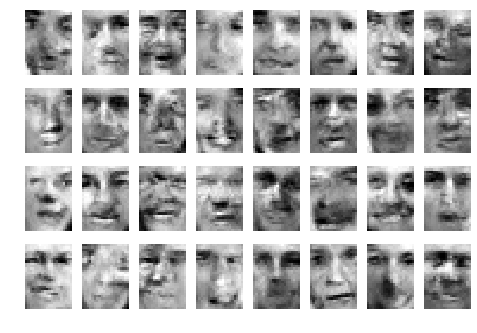


epoch 78: discriminator loss: 0.69	generator loss: 0.71


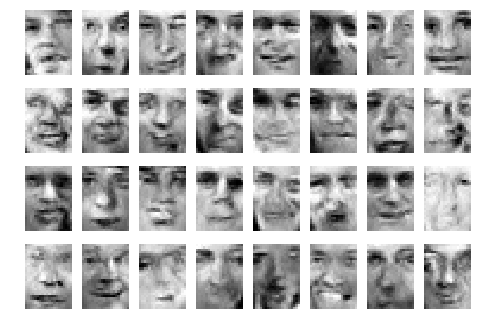


epoch 79: discriminator loss: 0.69	generator loss: 0.70


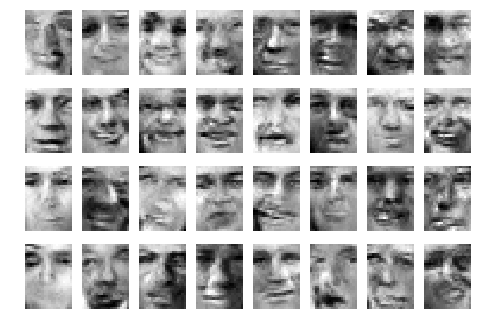


epoch 80: discriminator loss: 0.69	generator loss: 0.70


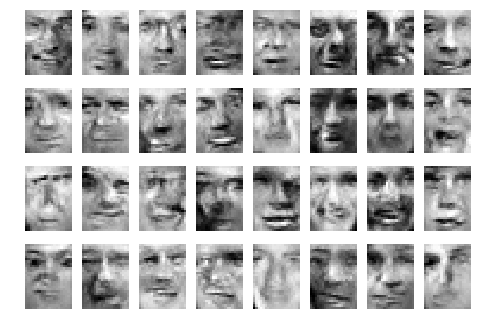


epoch 81: discriminator loss: 0.68	generator loss: 0.70


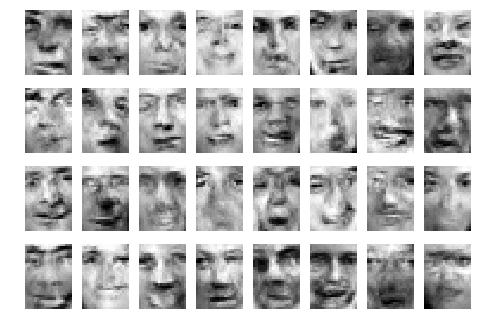


epoch 82: discriminator loss: 0.69	generator loss: 0.71


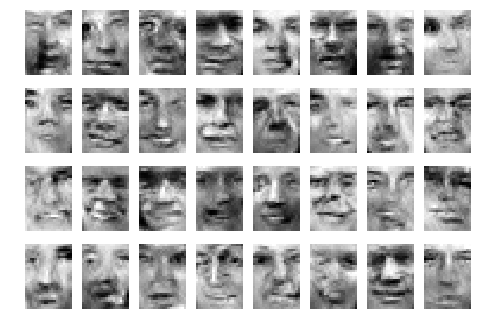


epoch 83: discriminator loss: 0.69	generator loss: 0.72


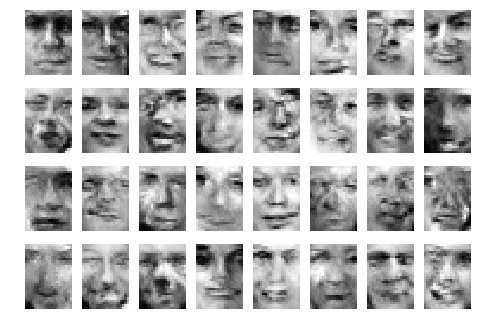


epoch 84: discriminator loss: 0.69	generator loss: 0.72


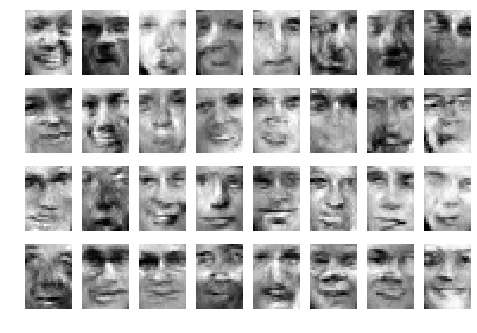


epoch 85: discriminator loss: 0.69	generator loss: 0.70


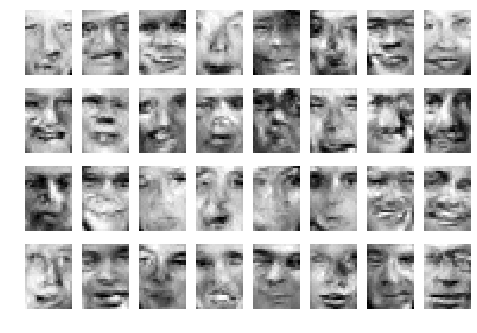


epoch 86: discriminator loss: 0.70	generator loss: 0.71


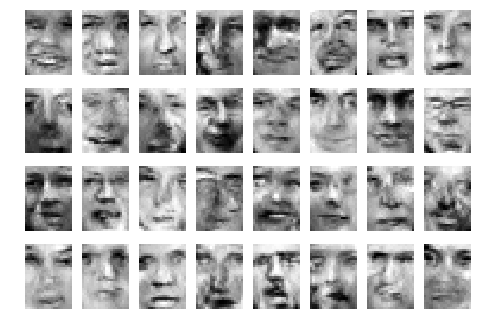


epoch 87: discriminator loss: 0.69	generator loss: 0.72


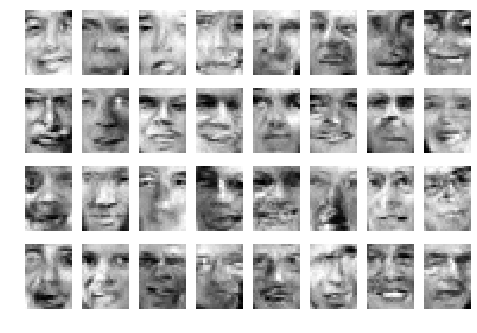


epoch 88: discriminator loss: 0.70	generator loss: 0.71


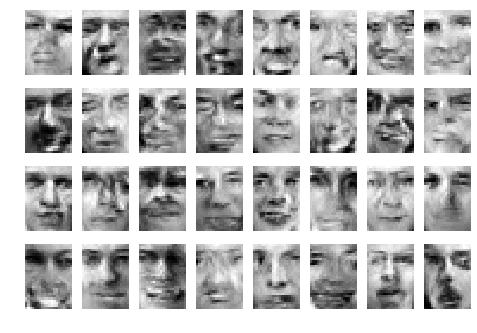


epoch 89: discriminator loss: 0.69	generator loss: 0.69


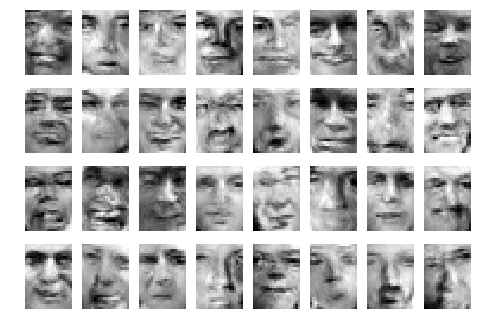


epoch 90: discriminator loss: 0.69	generator loss: 0.70


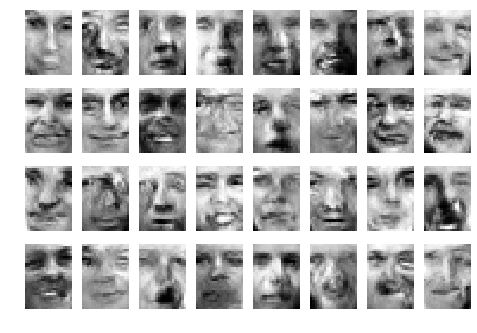


epoch 91: discriminator loss: 0.69	generator loss: 0.72


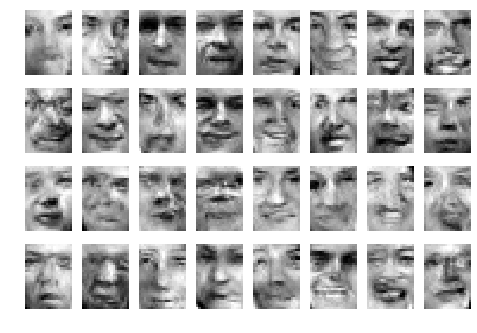


epoch 92: discriminator loss: 0.69	generator loss: 0.71


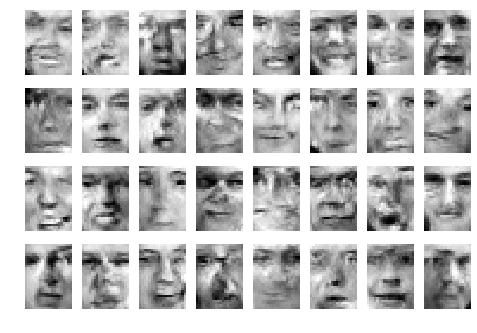


epoch 93: discriminator loss: 0.68	generator loss: 0.70


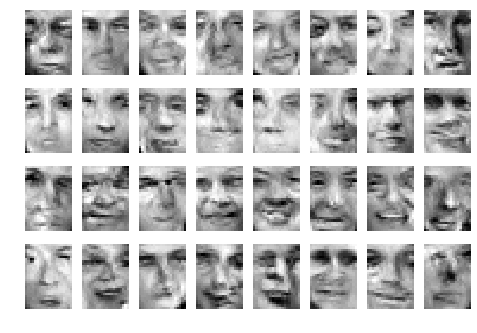


epoch 94: discriminator loss: 0.69	generator loss: 0.70


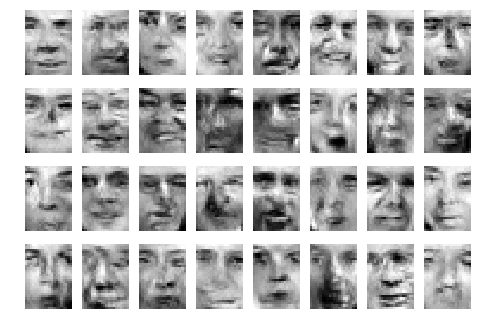


epoch 95: discriminator loss: 0.69	generator loss: 0.70


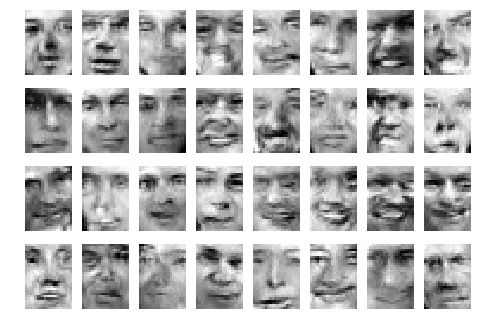


epoch 96: discriminator loss: 0.69	generator loss: 0.71


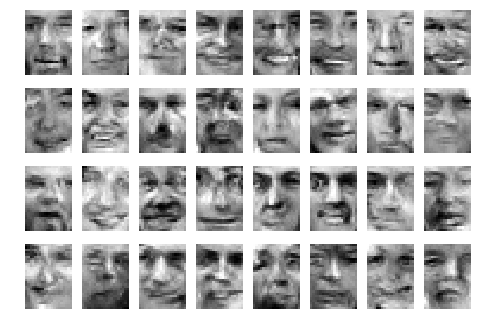


epoch 97: discriminator loss: 0.69	generator loss: 0.70


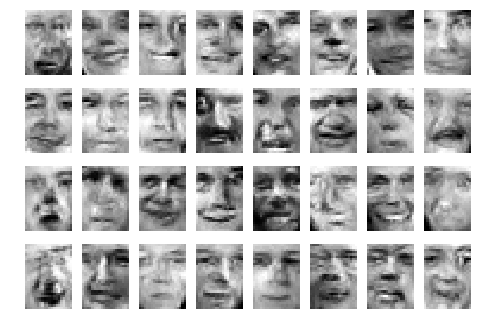


epoch 98: discriminator loss: 0.69	generator loss: 0.71


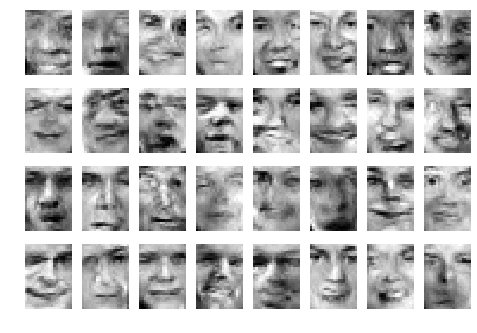


epoch 99: discriminator loss: 0.69	generator loss: 0.71


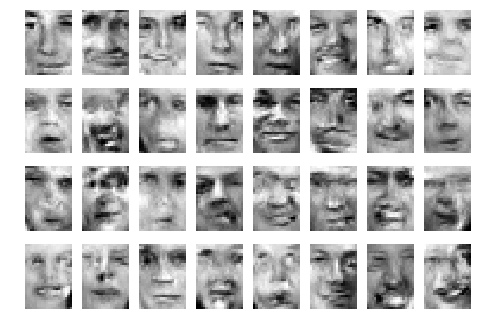


epoch 100: discriminator loss: 0.69	generator loss: 0.70


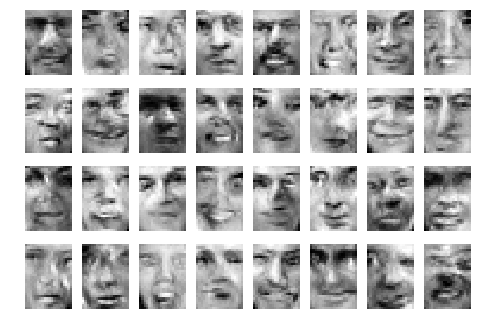

In [25]:
gen_loss_history, discrim_loss_history = train_gan(generator,discriminator,d_on_g,x_train)

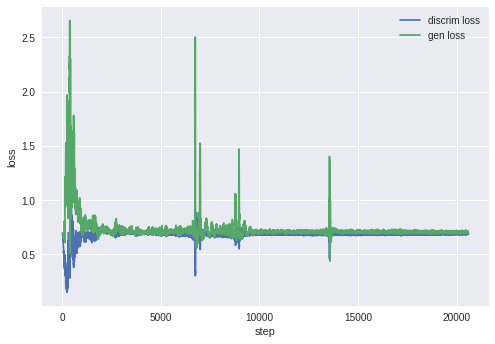

In [26]:
plt.plot(discrim_loss_history)
plt.plot(gen_loss_history)
plt.xlabel('step')
plt.ylabel('loss')
plt.legend(['discrim loss','gen loss'])
plt.show()